In [1]:
import mne
from mne.channels import make_standard_montage
from mne.preprocessing import ICA
from mne.preprocessing import create_eog_epochs, create_ecg_epochs
import matplotlib.pyplot as plt
import numpy as np
from mne.channels import find_ch_adjacency, make_1020_channel_selections
import glob
from mne.stats import spatio_temporal_cluster_1samp_test
import plotly.graph_objects as go
import gc  
from mne.stats import bonferroni_correction
import scipy.stats
from mne.stats import permutation_cluster_test

mne.set_log_level('error')  

In [2]:
all_channels = ['P7', 'P5', 'P3', 'PO7', 'PO3', 'O1', 'P4', 'P6', 'P8', 'PO4', 'PO8', 'O2', 'Pz','TP7', 'TP8', 'CP5',  'CP6', 'Fz', 'F3', 'F4', 'F5', 'F6', 'F7', 'F8', 'AFz', 'Cz']

In [3]:
left_channels = ['O1','PO3', 'P3', 'PO7', 'P5', 'P7', 'CP5', 'TP7']
right_channels = ['O2', 'PO4', 'P4','PO8', 'P6', 'P8', 'CP6', 'TP8']
occipital_parietal_channels = ['P7', 'P5', 'P3', 'PO7', 'PO3', 'O1', 'P4', 'P6', 'P8', 'PO4', 'PO8', 'O2', 'Pz']
frontal_channels_central = ['Fz', 'F3', 'F4', 'F5', 'F6', 'F7', 'F8', 'AFz', 'Cz'] 

In [4]:
def balance_epochs(epochs_standard, epochs_deviant):
    n_deviant = len(epochs_deviant)
    n_standard = len(epochs_standard)
    if n_standard > n_deviant:
        selected_indices = np.random.choice(n_standard, n_deviant, replace = False)
        epochs_standard = epochs_standard[selected_indices]
    return epochs_standard, epochs_deviant

In [6]:
from tqdm import tqdm 
# Путь к папке с файлами
base_path = "C:/Users/user/Downloads/data_vMMN/EEG_data/epochs_reject_re_ref/"
# Номера файлов, которые нужно загрузить
#file_numbers = [1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 30, 31, 32]
file_numbers = [1, 2, 3, 5, 6, 7, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42]
conditions = ['HA/impl/4', 'AN/impl/4', 'HA/impl/16', 'AN/impl/16', 
              'HA/expl/4', 'AN/expl/4', 'HA/expl/16', 'AN/expl/16', 
              'HA/report/4', 'AN/report/4', 'HA/report/16', 'AN/report/16']
erps = {}
for num in tqdm(file_numbers):

    file_path = f"{base_path}sub-{num}_ses-01_task-vMMNens_eeg_experiment.fif"
    epochs = mne.read_epochs(file_path, preload=True)
    for cond in conditions:
        standard_label = f'{cond}/standard'
        deviant_label = f'{cond}/deviant'
        if standard_label not in erps.keys():
            erps[standard_label] = []
            erps[deviant_label] = []
        try:
            balanced_std = epochs[standard_label]
            balanced_dev = epochs[deviant_label]
        except:
            erps[standard_label].append(np.nan)
            erps[deviant_label].append(np.nan)
            print(num)
            continue

        if len(epochs[standard_label]) > 0 and len(epochs[deviant_label]) > 0:
            balanced_std, balanced_dev = balance_epochs(epochs[standard_label], epochs[deviant_label])         

        
        erps[standard_label].append(balanced_std.average(picks = all_channels))
        erps[deviant_label].append(balanced_dev.average(picks = all_channels))
#        erps[standard_label].append(epochs[standard_label].average(picks = occipital_parietal_channels))
#        erps[deviant_label].append(epochs[deviant_label].average(picks = occipital_parietal_channels))


100%|██████████| 36/36 [29:33<00:00, 49.27s/it]


In [7]:
from tqdm import tqdm 
# Путь к папке с файлами
base_path = "C:/Users/user/Downloads/data_vMMN/EEG_data/EEG_epoch_data/"
# Номера файлов, которые нужно загрузить
file_numbers = [1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]
conditions = ['HA/impl/4', 'AN/impl/4', 'HA/impl/16', 'AN/impl/16', 
              'HA/expl/4', 'AN/expl/4', 'HA/expl/16', 'AN/expl/16', 
              'HA/report/4', 'AN/report/4', 'HA/report/16', 'AN/report/16']
erps = {}
for num in tqdm(file_numbers):
    file_path = f"{base_path}epochs_{num}-epo.fif"
    epochs = mne.read_epochs(file_path, preload=True)
    for cond in conditions:
        standard_label = f'{cond}/standard'
        deviant_label = f'{cond}/deviant'
        if standard_label not in erps.keys():
            erps[standard_label] = []
            erps[deviant_label] = []
        try:
            balanced_std = epochs[standard_label]
            balanced_dev = epochs[deviant_label]
        except:
            erps[standard_label].append(np.nan)
            erps[deviant_label].append(np.nan)
            print(num)
            continue

        if len(epochs[standard_label]) > 0 and len(epochs[deviant_label]) > 0:
            balanced_std, balanced_dev = balance_epochs(epochs[standard_label], epochs[deviant_label])         

        
        erps[standard_label].append(balanced_std.average(picks = all_channels))
        erps[deviant_label].append(balanced_dev.average(picks = all_channels))
#        erps[standard_label].append(epochs[standard_label].average(picks = occipital_parietal_channels))
#        erps[deviant_label].append(epochs[deviant_label].average(picks = occipital_parietal_channels))


100%|██████████| 19/19 [40:13<00:00, 127.03s/it]


In [7]:

condition_groups = {
    "impl/4/standard": ["HA/impl/4/standard", "AN/impl/4/standard"],
    "impl/4/deviant": ["HA/impl/4/deviant", "AN/impl/4/deviant"],
    "impl/16/standard": ["HA/impl/16/standard", "AN/impl/16/standard"],
    "impl/16/deviant": ["HA/impl/16/deviant", "AN/impl/16/deviant"],
    "expl/4/standard": ["HA/expl/4/standard", "AN/expl/4/standard"],
    "expl/4/deviant": ["HA/expl/4/deviant", "AN/expl/4/deviant"],
    "expl/16/standard": ["HA/expl/16/standard", "AN/expl/16/standard"],
    "expl/16/deviant": ["HA/expl/16/deviant", "AN/expl/16/deviant"],
    "report/4/standard": ["HA/report/4/standard", "AN/report/4/standard"],
    "report/4/deviant": ["HA/report/4/deviant", "AN/report/4/deviant"],
    "report/16/standard": ["HA/report/16/standard", "AN/report/16/standard"],
    "report/16/deviant": ["HA/report/16/deviant", "AN/report/16/deviant"],
    "HA/impl/standard": ["HA/impl/4/standard", "HA/impl/16/standard"],
    "AN/impl/standard": ["AN/impl/4/standard", "AN/impl/16/standard"],
    "HA/expl/standard": ["HA/expl/4/standard", "HA/expl/16/standard"],
    "AN/expl/standard": ["AN/expl/4/standard", "AN/expl/16/standard"],    
    "HA/report/standard": ["HA/report/4/standard", "HA/report/16/standard"],
    "AN/report/standard": ["AN/report/4/standard", "AN/report/16/standard"], 
    "AN/impl/deviant": ["HA/impl/4/deviant", "HA/impl/16/deviant"],
    "HA/impl/deviant": ["AN/impl/4/deviant", "AN/impl/16/deviant"],
    "AN/expl/deviant": ["HA/expl/4/deviant", "HA/expl/16/deviant"],
    "HA/expl/deviant": ["AN/expl/4/deviant", "AN/expl/16/deviant"],    
    "AN/report/deviant": ["HA/report/4/deviant", "HA/report/16/deviant"],
    "HA/report/deviant": ["AN/report/4/deviant", "AN/report/16/deviant"],     


    "impl/standard": ["HA/impl/4/standard", "HA/impl/16/standard", "AN/impl/4/standard", "AN/impl/16/standard"],
    "expl/standard": ["HA/expl/4/standard", "HA/expl/16/standard", "AN/expl/4/standard", "AN/expl/16/standard"],
    "report/standard": ["HA/report/4/standard", "HA/report/16/standard", "AN/report/4/standard", "AN/report/16/standard"],

    "impl/deviant": ["HA/impl/4/deviant", "HA/impl/16/deviant", "AN/impl/4/deviant", "AN/impl/16/deviant"],
    "expl/deviant": ["HA/expl/4/deviant", "HA/expl/16/deviant", "AN/expl/4/deviant", "AN/expl/16/deviant"],
    "report/deviant": ["HA/report/4/deviant", "HA/report/16/deviant", "AN/report/4/deviant", "AN/report/16/deviant"],   

    
    "HA/impl/4": ["HA/impl/4/standard", "HA/impl/4/deviant"], 
    "AN/impl/4": ["AN/impl/4/standard", "AN/impl/4/deviant"],     
    "HA/impl/16": ["HA/impl/16/standard", "HA/impl/16/deviant"], 
    "AN/impl/16": ["AN/impl/16/standard", "AN/impl/16/deviant"], 
    "HA/expl/4": ["HA/expl/4/standard", "HA/expl/4/deviant"],
    "AN/expl/4": ["AN/expl/4/standard", "AN/expl/4/deviant"],
    "HA/expl/16": ["HA/expl/16/standard", "HA/expl/16/deviant"],
    "AN/expl/16": ["AN/expl/16/standard", "AN/expl/16/deviant"],
    "HA/report/4": ["HA/report/4/standard", "HA/report/4/deviant"],
    "AN/report/4": ["AN/report/4/standard", "AN/report/4/deviant"],
    "HA/report/16": ["HA/report/16/standard", "HA/report/16/deviant"],
    "AN/report/16": ["AN/report/16/standard", "AN/report/16/deviant"],
    
    "impl/4": ["HA/impl/4/standard", "HA/impl/4/deviant", "AN/impl/4/standard", "AN/impl/4/deviant"],
    "impl/16": ["HA/impl/16/standard", "HA/impl/16/deviant", "AN/impl/16/standard", "AN/impl/16/deviant"],
    "expl/4": ["HA/expl/4/standard", "HA/expl/4/deviant", "AN/expl/4/standard", "AN/expl/4/deviant"],
    "expl/16": ["HA/expl/16/standard", "HA/expl/16/deviant", "AN/expl/16/standard", "AN/expl/16/deviant"],
    "report/4": ["HA/report/4/standard", "HA/report/4/deviant", "AN/report/4/standard", "AN/report/4/deviant"],
    "report/16": ["HA/report/16/standard", "HA/report/16/deviant", "AN/report/16/standard", "AN/report/16/deviant"],

    "HA/impl": ["HA/impl/4/standard", "AN/impl/4/deviant", "HA/impl/16/standard", "AN/impl/16/deviant"],
    "AN/impl": ["AN/impl/4/standard", "HA/impl/4/deviant", "AN/impl/16/standard", "HA/impl/16/deviant"],

    "HA/expl": ["HA/expl/4/standard", "AN/expl/4/deviant", "HA/expl/16/standard", "AN/expl/16/deviant"],
    "AN/expl": ["AN/expl/4/standard", "HA/expl/4/deviant", "AN/expl/16/standard", "HA/expl/16/deviant"],

    "HA/report": ["HA/report/4/standard", "AN/report/4/deviant", "HA/report/16/standard", "AN/report/16/deviant"],
    "AN/report": ["AN/report/4/standard", "HA/report/4/deviant", "AN/report/16/standard", "HA/report/16/deviant"],

    
    "impl": ["HA/impl/4/standard", "HA/impl/4/deviant", "HA/impl/16/standard", "HA/impl/16/deviant", "AN/impl/4/standard", "AN/impl/4/deviant", "AN/impl/16/standard", "AN/impl/16/deviant"],
    "expl": ["HA/expl/4/standard", "HA/expl/4/deviant", "HA/expl/16/standard", "HA/expl/16/deviant", "AN/expl/4/standard", "AN/expl/4/deviant", "AN/expl/16/standard", "AN/expl/16/deviant"],
    "report": ["HA/report/4/standard", "HA/report/4/deviant", "HA/report/16/standard", "HA/report/16/deviant", "AN/report/4/standard", "AN/report/4/deviant", "AN/report/16/standard", "AN/report/16/deviant"]

}


if not isinstance(erps, dict):
    raise TypeError("Переменная 'erps' должна быть словарем.")

# Объединяем данные из указанных условий
for new_condition, sources in condition_groups.items():
    erps[new_condition] = [erp for src in sources for erp in erps.get(src, [])]


In [23]:

condition_groups = {
    "HA/impl/4/standard":["HA/impl/4/standard"],
    "AN/impl/4/standard":["AN/impl/4/standard"],
    "HA/impl/16/standard":["HA/impl/16/standard"],
    "AN/impl/16/standard":["AN/impl/16/standard"],
    "AN/impl/4/deviant":["HA/impl/4/deviant"],
    "HA/impl/4/deviant":["AN/impl/4/deviant"],
    "AN/impl/16/deviant":["HA/impl/16/deviant"],
    "HA/impl/16/deviant":["AN/impl/16/deviant"],

    "HA/expl/4/standard":["HA/expl/4/standard"],
    "AN/expl/4/standard":["AN/expl/4/standard"],
    "HA/expl/16/standard":["HA/expl/16/standard"],
    "AN/expl/16/standard":["AN/expl/16/standard"],
    "AN/expl/4/deviant":["HA/expl/4/deviant"],
    "HA/expl/4/deviant":["AN/expl/4/deviant"],
    "AN/expl/16/deviant":["HA/expl/16/deviant"],
    "HA/expl/16/deviant":["AN/expl/16/deviant"],

    "HA/report/4/standard":["HA/report/4/standard"],
    "AN/report/4/standard":["AN/report/4/standard"],
    "HA/report/16/standard":["HA/report/16/standard"],
    "AN/report/16/standard":["AN/report/16/standard"],
    "AN/report/4/deviant":["HA/report/4/deviant"],
    "HA/report/4/deviant":["AN/report/4/deviant"],
    "AN/report/16/deviant":["HA/report/16/deviant"],
    "HA/report/16/deviant":["AN/report/16/deviant"],
    
    "impl/4/standard": ["HA/impl/4/standard", "AN/impl/4/standard"],
    "impl/4/deviant": ["HA/impl/4/deviant", "AN/impl/4/deviant"],
    "impl/16/standard": ["HA/impl/16/standard", "AN/impl/16/standard"],
    "impl/16/deviant": ["HA/impl/16/deviant", "AN/impl/16/deviant"],
    "expl/4/standard": ["HA/expl/4/standard", "AN/expl/4/standard"],
    "expl/4/deviant": ["HA/expl/4/deviant", "AN/expl/4/deviant"],
    "expl/16/standard": ["HA/expl/16/standard", "AN/expl/16/standard"],
    "expl/16/deviant": ["HA/expl/16/deviant", "AN/expl/16/deviant"],
    "report/4/standard": ["HA/report/4/standard", "AN/report/4/standard"],
    "report/4/deviant": ["HA/report/4/deviant", "AN/report/4/deviant"],
    "report/16/standard": ["HA/report/16/standard", "AN/report/16/standard"],
    "report/16/deviant": ["HA/report/16/deviant", "AN/report/16/deviant"],
    "HA/impl/standard": ["HA/impl/4/standard", "HA/impl/16/standard"],
    "AN/impl/standard": ["AN/impl/4/standard", "AN/impl/16/standard"],
    "HA/expl/standard": ["HA/expl/4/standard", "HA/expl/16/standard"],
    "AN/expl/standard": ["AN/expl/4/standard", "AN/expl/16/standard"],    
    "HA/report/standard": ["HA/report/4/standard", "HA/report/16/standard"],
    "AN/report/standard": ["AN/report/4/standard", "AN/report/16/standard"], 
    "AN/impl/deviant": ["HA/impl/4/deviant", "HA/impl/16/deviant"],
    "HA/impl/deviant": ["AN/impl/4/deviant", "AN/impl/16/deviant"],
    "AN/expl/deviant": ["HA/expl/4/deviant", "HA/expl/16/deviant"],
    "HA/expl/deviant": ["AN/expl/4/deviant", "AN/expl/16/deviant"],    
    "AN/report/deviant": ["HA/report/4/deviant", "HA/report/16/deviant"],
    "HA/report/deviant": ["AN/report/4/deviant", "AN/report/16/deviant"],     


    "impl/standard": ["HA/impl/4/standard", "HA/impl/16/standard", "AN/impl/4/standard", "AN/impl/16/standard"],
    "expl/standard": ["HA/expl/4/standard", "HA/expl/16/standard", "AN/expl/4/standard", "AN/expl/16/standard"],
    "report/standard": ["HA/report/4/standard", "HA/report/16/standard", "AN/report/4/standard", "AN/report/16/standard"],

    "impl/deviant": ["HA/impl/4/deviant", "HA/impl/16/deviant", "AN/impl/4/deviant", "AN/impl/16/deviant"],
    "expl/deviant": ["HA/expl/4/deviant", "HA/expl/16/deviant", "AN/expl/4/deviant", "AN/expl/16/deviant"],
    "report/deviant": ["HA/report/4/deviant", "HA/report/16/deviant", "AN/report/4/deviant", "AN/report/16/deviant"],   

    
    "HA/impl/4": ["HA/impl/4/standard", "AN/impl/4/deviant"], 
    "AN/impl/4": ["AN/impl/4/standard", "HA/impl/4/deviant"],     
    "HA/impl/16": ["HA/impl/16/standard", "AN/impl/16/deviant"], 
    "AN/impl/16": ["AN/impl/16/standard", "HA/impl/16/deviant"], 
    "HA/expl/4": ["HA/expl/4/standard", "AN/expl/4/deviant"],
    "AN/expl/4": ["AN/expl/4/standard", "HA/expl/4/deviant"],
    "HA/expl/16": ["HA/expl/16/standard", "AN/expl/16/deviant"],
    "AN/expl/16": ["AN/expl/16/standard", "HA/expl/16/deviant"],
    "HA/report/4": ["HA/report/4/standard", "AN/report/4/deviant"],
    "AN/report/4": ["AN/report/4/standard", "HA/report/4/deviant"],
    "HA/report/16": ["HA/report/16/standard", "AN/report/16/deviant"],
    "AN/report/16": ["AN/report/16/standard", "HA/report/16/deviant"],
    
    "impl/4": ["HA/impl/4/standard", "HA/impl/4/deviant", "AN/impl/4/standard", "AN/impl/4/deviant"],
    "impl/16": ["HA/impl/16/standard", "HA/impl/16/deviant", "AN/impl/16/standard", "AN/impl/16/deviant"],
    "expl/4": ["HA/expl/4/standard", "HA/expl/4/deviant", "AN/expl/4/standard", "AN/expl/4/deviant"],
    "expl/16": ["HA/expl/16/standard", "HA/expl/16/deviant", "AN/expl/16/standard", "AN/expl/16/deviant"],
    "report/4": ["HA/report/4/standard", "HA/report/4/deviant", "AN/report/4/standard", "AN/report/4/deviant"],
    "report/16": ["HA/report/16/standard", "HA/report/16/deviant", "AN/report/16/standard", "AN/report/16/deviant"],

    "HA/impl": ["HA/impl/4/standard", "AN/impl/4/deviant", "HA/impl/16/standard", "AN/impl/16/deviant"],
    "AN/impl": ["AN/impl/4/standard", "HA/impl/4/deviant", "AN/impl/16/standard", "HA/impl/16/deviant"],

    "HA/expl": ["HA/expl/4/standard", "AN/expl/4/deviant", "HA/expl/16/standard", "AN/expl/16/deviant"],
    "AN/expl": ["AN/expl/4/standard", "HA/expl/4/deviant", "AN/expl/16/standard", "HA/expl/16/deviant"],

    "HA/report": ["HA/report/4/standard", "AN/report/4/deviant", "HA/report/16/standard", "AN/report/16/deviant"],
    "AN/report": ["AN/report/4/standard", "HA/report/4/deviant", "AN/report/16/standard", "HA/report/16/deviant"],

    
    "impl": ["HA/impl/4/standard", "HA/impl/4/deviant", "HA/impl/16/standard", "HA/impl/16/deviant", "AN/impl/4/standard", "AN/impl/4/deviant", "AN/impl/16/standard", "AN/impl/16/deviant"],
    "expl": ["HA/expl/4/standard", "HA/expl/4/deviant", "HA/expl/16/standard", "HA/expl/16/deviant", "AN/expl/4/standard", "AN/expl/4/deviant", "AN/expl/16/standard", "AN/expl/16/deviant"],
    "report": ["HA/report/4/standard", "HA/report/4/deviant", "HA/report/16/standard", "HA/report/16/deviant", "AN/report/4/standard", "AN/report/4/deviant", "AN/report/16/standard", "AN/report/16/deviant"]

}


merged_erps = {}

for new_key, sub_conditions in condition_groups.items():
    merged_erps[new_key] = []
    
    # Количество участников его нужно поменять на 28
    n_subjects = 36

    for i_subj in range(n_subjects):
        evoked_list = []
        n_eps_total = 0 
        for cond in sub_conditions:
            if cond in erps and len(erps[cond]) > i_subj:
                evoked = erps[cond][i_subj]
                evoked_list.append(evoked.data)
                n_eps_total += evoked.nave
        
        if evoked_list:
            merged_data = np.mean(evoked_list, axis = 0)
            #merged_data = np.concatinate(evoked_list, axis = 1)
            #новые evoked
            new_evoked = erps[sub_conditions[0]][i_subj].copy()
            new_evoked.data = merged_data
            new_evoked.nave = n_eps_total  # Сумма усреднённых эпох
            new_evoked.comment = new_key  # Новое имя условия
            # !!! Обновить time_axis нужно вручную, если меняется длина данных
            merged_erps[new_key].append(new_evoked)


In [24]:
grand_averages = {}

# 1. Создаём grand average для обычных условий
for key, evokeds in merged_erps.items():
    filtered_evokeds = list(filter(lambda x: type(x).__name__ == 'EvokedArray', evokeds))
    if filtered_evokeds:
        grand_averages[key] = mne.grand_average(filtered_evokeds)

grand_averages

{'HA/impl/4/standard': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 26 ch, ~219 kB>,
 'AN/impl/4/standard': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 26 ch, ~219 kB>,
 'HA/impl/16/standard': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 26 ch, ~219 kB>,
 'AN/impl/16/standard': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 26 ch, ~219 kB>,
 'AN/impl/4/deviant': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 26 ch, ~219 kB>,
 'HA/impl/4/deviant': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 26 ch, ~219 kB>,
 'AN/impl/16/deviant': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 26 ch, ~219 kB>,
 'HA/impl/16/deviant': <Evoked | 'Grand average (n = 36)' (average, N=36), -0.2 – 0.6 s, baseline -0.2 – 0 s, 2

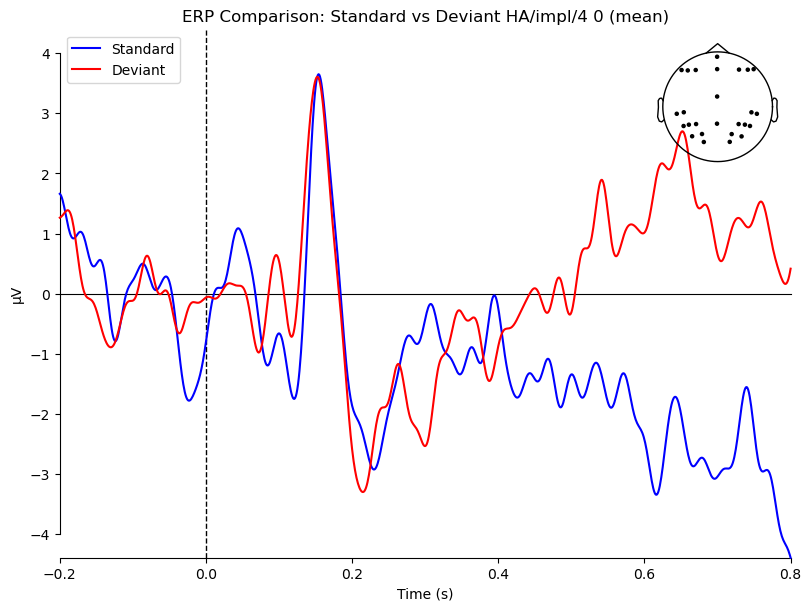

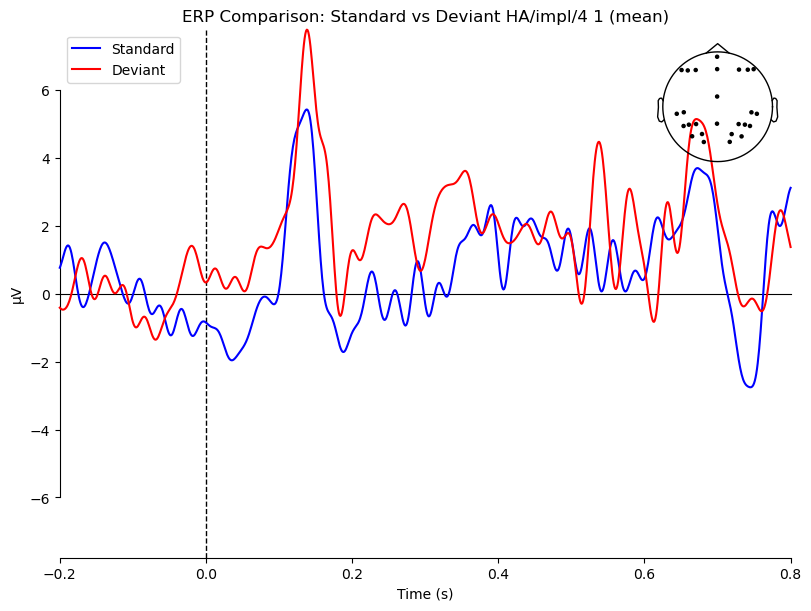

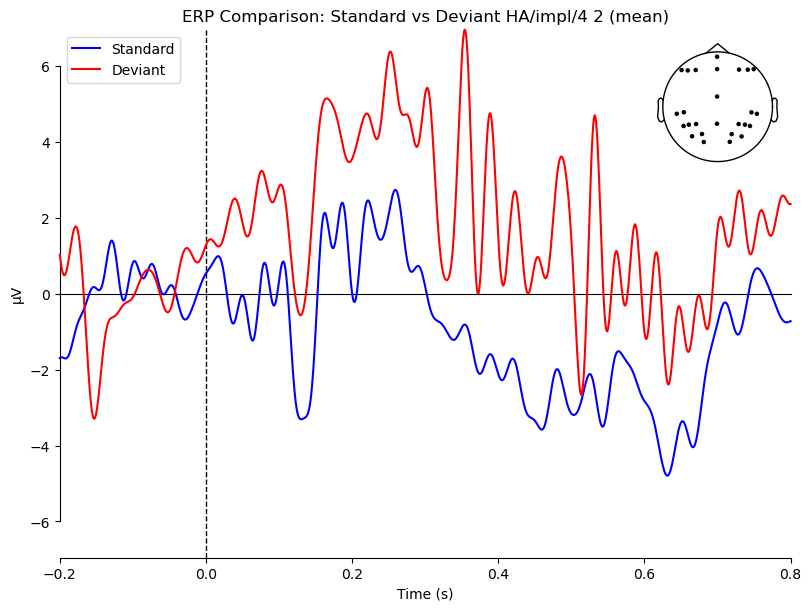

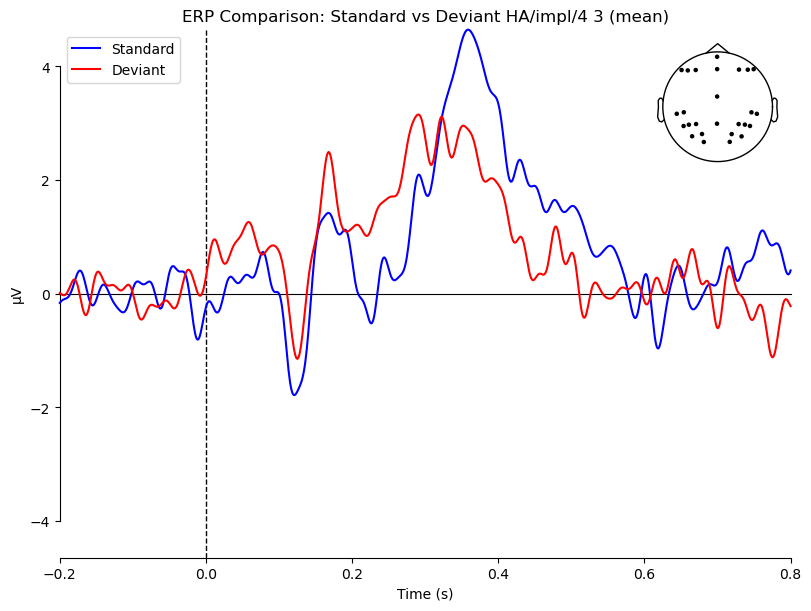

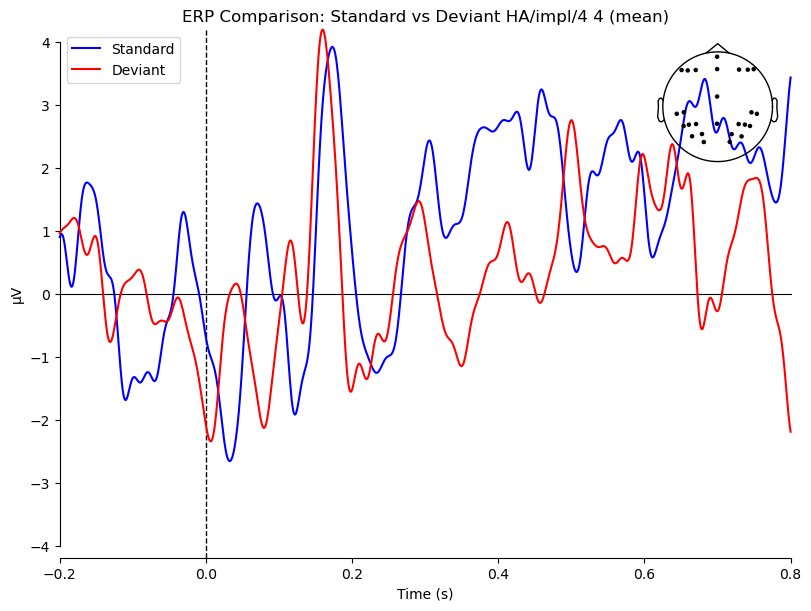

...

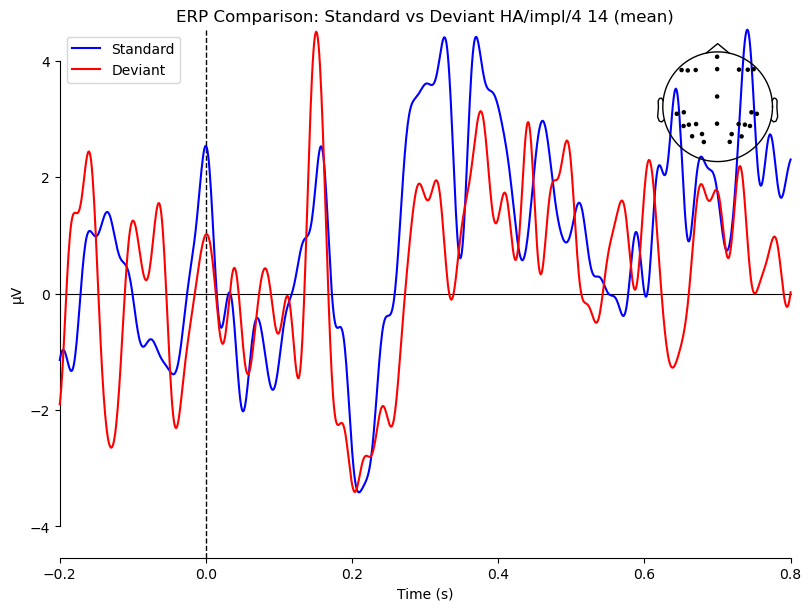

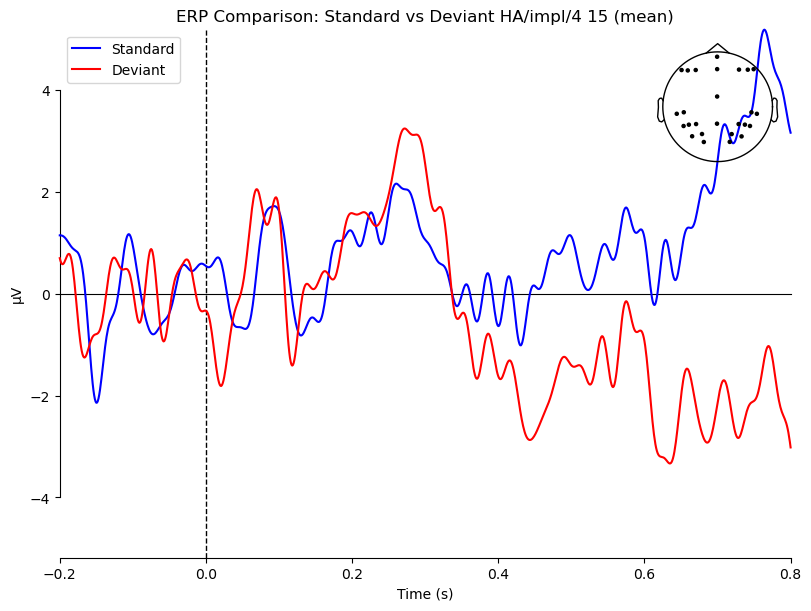

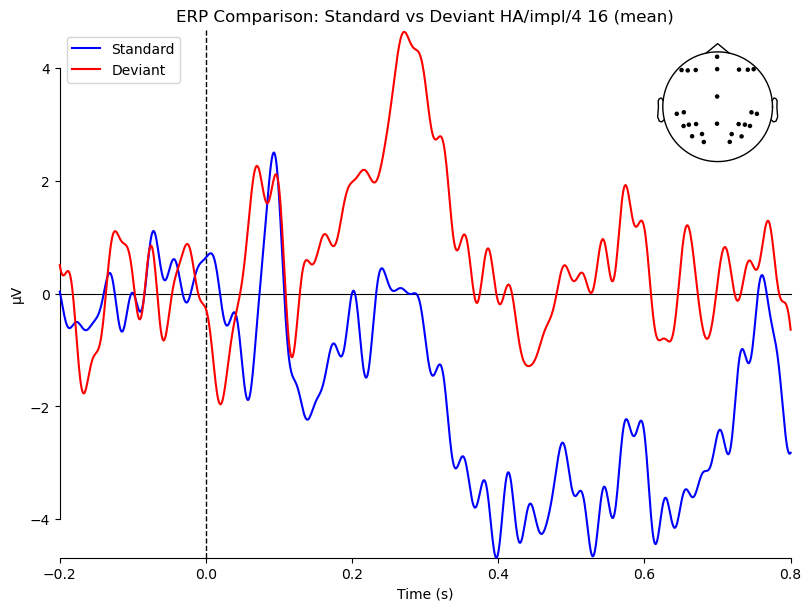

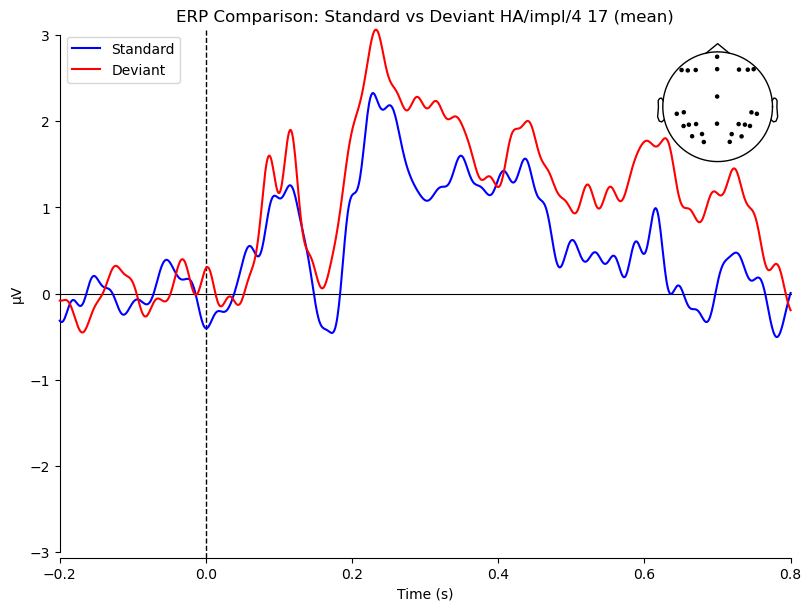

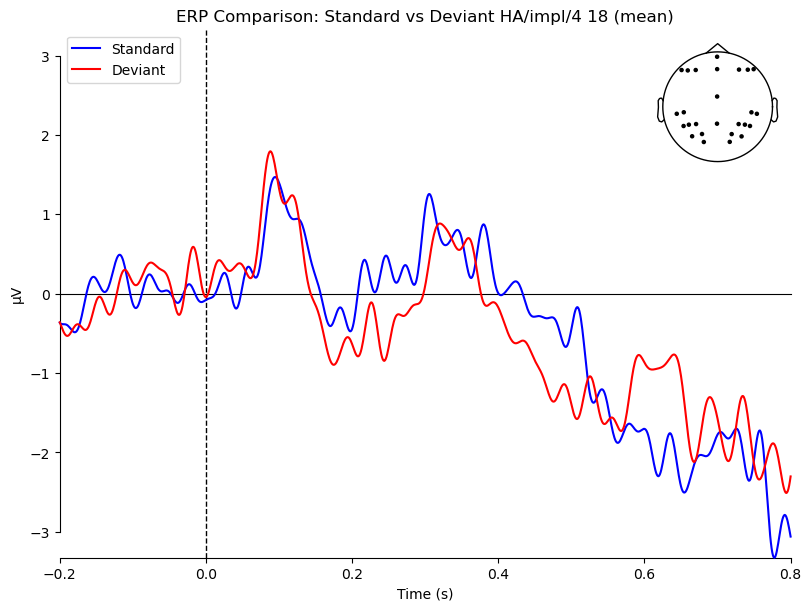

IndexError: list index out of range

In [10]:
conditions = [
    "HA/impl/4", "HA/impl/16", "AN/impl/4", "AN/impl/16",
    "HA/expl/4", "HA/expl/16", "AN/expl/4", "AN/expl/16",
    "HA/report/4", "HA/report/16", "AN/report/4", "AN/report/16"]
n = 34
for cond in conditions:
    for i in range(n):
    # Extract the evoked objects

        standard_key = f"{cond}/standard"
        deviant_key = f"{cond}/deviant"

        evoked_standard = erps[standard_key][i]
        evoked_deviant = erps[deviant_key][i]

    # Combine and plot
        mne.viz.plot_compare_evokeds(
            {'Standard': evoked_standard, 'Deviant': evoked_deviant},
            picks='eeg',  # or a specific channel name or index
            combine='mean',  # averages channels if more than one is selected
            colors={'Standard': 'blue', 'Deviant': 'red'},
            show_sensors=True,
            legend=True,
            title=f'ERP Comparison: Standard vs Deviant {cond} {i}'
        )

In [52]:
i

1

**cluster t-test**

occipital parietal channels

Using a threshold of 3.977779
stat_fun(H1): min=8.815396261011937e-08 max=2.456382726215521
Running initial clustering …
Found 0 clusters

Условие: HA/impl/4 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\1192946952.py:50: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\1192946952.py:50: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



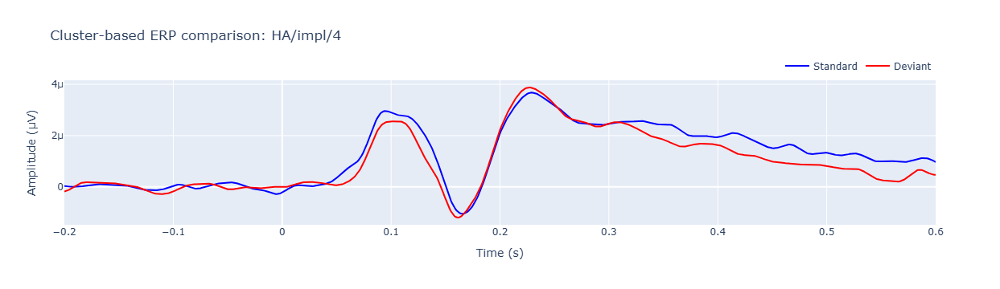

Using a threshold of 3.977779
stat_fun(H1): min=2.47279819811392e-06 max=3.3649742513261804
Running initial clustering …
Found 0 clusters

Условие: HA/impl/16 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\1192946952.py:50: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\1192946952.py:50: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



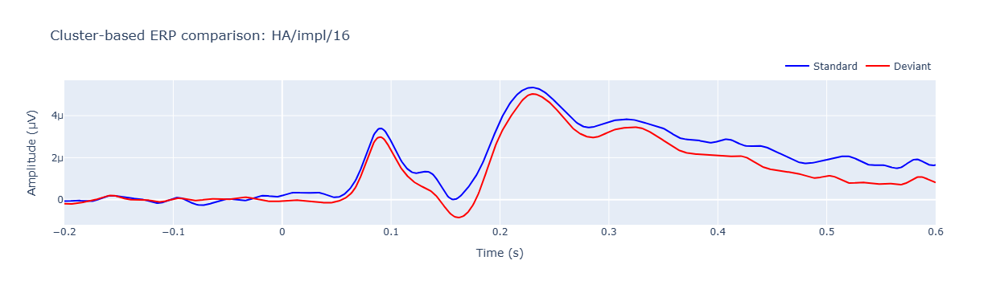

Using a threshold of 3.977779
stat_fun(H1): min=6.942232407340492e-06 max=4.011989853271353
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\1192946952.py:50: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: AN/impl/4 — Значимые кластеры (p < 0.05):


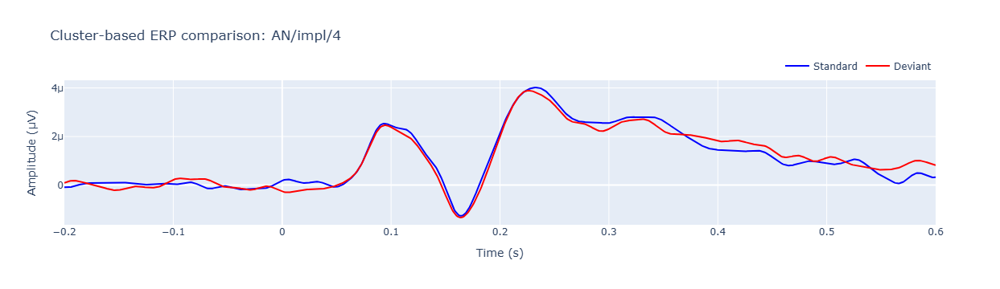

Using a threshold of 3.977779
stat_fun(H1): min=7.725117633953749e-07 max=5.679662696158484
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\1192946952.py:50: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]

PermissionError: [WinError 32] Процесс не может получить доступ к файлу, так как этот файл занят другим процессом: 'C:\\Users\\user\\AppData\\Local\\Temp\\tmp_mne_progan2ze4bt'

In [42]:
# Оусловия
conditions = [
    "HA/impl/4", "HA/impl/16", "AN/impl/4", "AN/impl/16",
    "HA/expl/4", "HA/expl/16", "AN/expl/4", "AN/expl/16",
    "HA/report/4", "HA/report/16", "AN/report/4", "AN/report/16",
    "HA/impl", "AN/impl", "HA/expl", "AN/expl", "HA/report", "AN/report",    
    "impl/4", "impl/16", "expl/4", "expl/16", "report/4", "report/16",
    "impl", "expl", "report"
]

for condition in conditions:
    standard_key = f"{condition}/standard"
    deviant_key = f"{condition}/deviant"

    if standard_key not in erps or deviant_key not in merged_erps:
        print(f"Нет данных для {condition}")
        continue

    # Удаляем NaN
    standard_erps = [ev for ev in merged_erps[standard_key] if isinstance(ev, mne.Evoked)]
    deviant_erps = [ev for ev in merged_erps[deviant_key] if isinstance(ev, mne.Evoked)]

    if not standard_erps or not deviant_erps:
        print(f"Пустые данные для {condition}")
        continue

    ch_names = standard_erps[0].ch_names
    selected_indices = [i for i, ch in enumerate(ch_names) if ch in occipital_parietal_channels]

    if not selected_indices:
        print(f"Нет нужных каналов в {condition}")
        continue

    
    data_standard = np.array([ev.data[selected_indices, :] for ev in standard_erps])
    data_deviant = np.array([ev.data[selected_indices, :] for ev in deviant_erps])

    data_standard = data_standard.mean(axis = 1)
    data_deviant = data_deviant.mean(axis = 1)
    
    n_subjects, n_times = data_standard.shape
    times = standard_erps[0].times
    
    X = [
        data_deviant,
        data_standard
    ]

    # Кластерный t-тест
    T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
        X, n_permutations=2000, tail=0, threshold=None,
        out_type='mask', verbose=True
    )

    '''
    
    data_diff = data_deviant - data_standard  # shape: (subjects, channels, times)
    
    # Перестановочный кластерный одновыборочный t-тест (сравнение разности с 0)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_1samp_test(
        data_diff,
        n_permutations=2000,
        tail=0,  # двусторонний тест
        threshold=None,
        out_type='mask',
        verbose=True
    )
    '''

    # Результаты
    print(f"\nУсловие: {condition} — Значимые кластеры (p < 0.05):")
    for i_cl, cl in enumerate(clusters):
        if cluster_p_values[i_cl] < 0.05:
            mask = cl.reshape(n_times, n_channels).T
            time_mask = np.any(mask, axis=0)
            time_indices = np.where(time_mask)[0]
            if len(time_indices) == 0:
                continue
            start_time = times[time_indices[0]]
            end_time = times[time_indices[-1]]
            mean_t = np.mean(T_obs[time_mask])
            print(f"Кластер {i_cl}: p = {cluster_p_values[i_cl]:.4f}, "
                  f"mean t = {mean_t:.3f}, "
                  f"время = {start_time:.3f} – {end_time:.3f} с")

    # Визуализация
    if standard_key in grand_averages and deviant_key in grand_averages:
        std_data = grand_averages[standard_key].copy().pick_channels(occipital_parietal_channels).data.mean(axis=0)
        dev_data = grand_averages[deviant_key].copy().pick_channels(occipital_parietal_channels).data.mean(axis=0)

        fig = go.Figure()
        fig.add_trace(go.Scatter(x=times, y=std_data, mode='lines', name='Standard', line=dict(color='blue')))
        fig.add_trace(go.Scatter(x=times, y=dev_data, mode='lines', name='Deviant', line=dict(color='red')))

        for i_cl, cl in enumerate(clusters):
            if cluster_p_values[i_cl] < 0.05:
                mask = cl.reshape(n_times, n_channels).T
                time_mask = np.any(mask, axis=0)
                time_indices = np.where(time_mask)[0]
                if len(time_indices) == 0:
                    continue
                start_time = times[time_indices[0]]
                end_time = times[time_indices[-1]]
                mean_t = np.mean(T_obs[time_mask])
                ymin = min(std_data.min(), dev_data.min())
                ymax = max(std_data.max(), dev_data.max())

                fig.add_trace(go.Scatter(
                    x=[start_time, end_time, end_time, start_time, start_time],
                    y=[ymin, ymin, ymax, ymax, ymin],
                    fill="toself",
                    fillcolor="rgba(0, 255, 0, 0.2)",
                    line=dict(color='rgba(0,0,0,0)'),
                    name=f"Cluster {i_cl}: p={cluster_p_values[i_cl]:.3f}, t={mean_t:.2f}",
                    hoverinfo="skip"
                ))

        fig.update_layout(
            title=f'Cluster-based ERP comparison: {condition}',
            xaxis_title='Time (s)',
            yaxis_title='Amplitude (µV)',
            hovermode='x unified',
            legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
        )
        fig.show()


frontal channels

Using a threshold of 3.977779
stat_fun(H1): min=5.8362388846115766e-06 max=5.815603525815585
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: HA/impl — Значимые кластеры (p < 0.05):


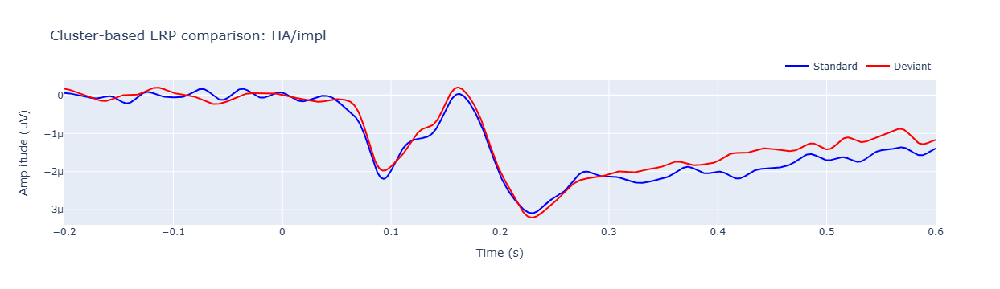

Using a threshold of 3.977779
stat_fun(H1): min=2.597613586633738e-06 max=8.749854768912995
Running initial clustering …
Found 3 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: AN/impl — Значимые кластеры (p < 0.05):


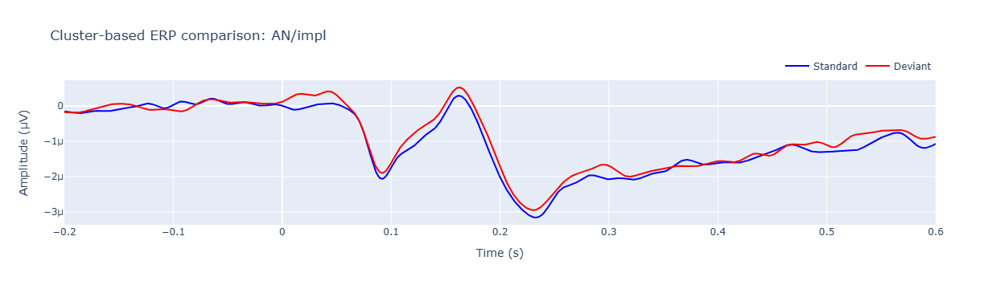

Using a threshold of 3.977779
stat_fun(H1): min=1.3032139338707073e-09 max=5.592390980925948
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: HA/expl — Значимые кластеры (p < 0.05):


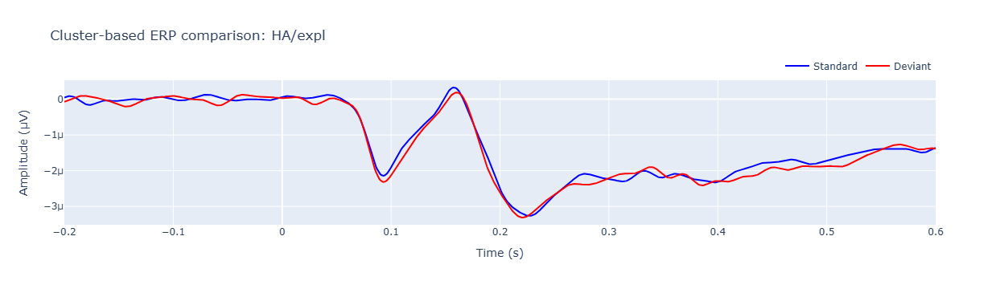

Using a threshold of 3.977779
stat_fun(H1): min=2.157546510980317e-05 max=4.110553289173988
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: AN/expl — Значимые кластеры (p < 0.05):


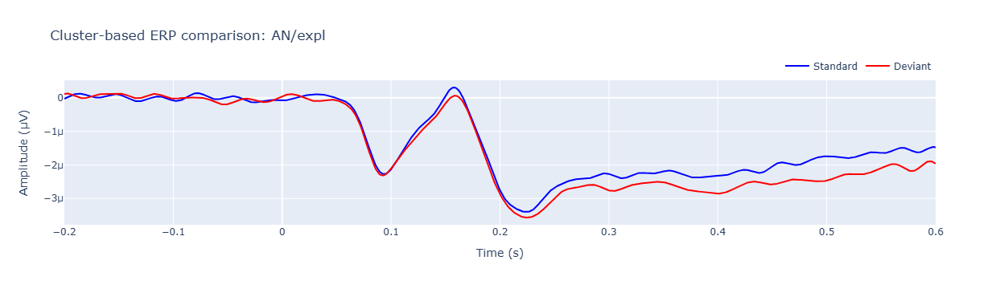

Using a threshold of 3.977779
stat_fun(H1): min=8.647859717717597e-07 max=5.854796262436252
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: HA/report — Значимые кластеры (p < 0.05):


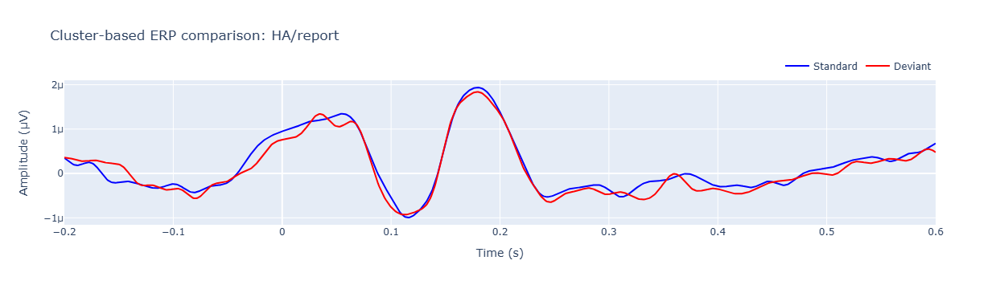

Using a threshold of 3.977779
stat_fun(H1): min=3.428870778438295e-07 max=1.260638622724461
Running initial clustering …
Found 0 clusters

Условие: AN/report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



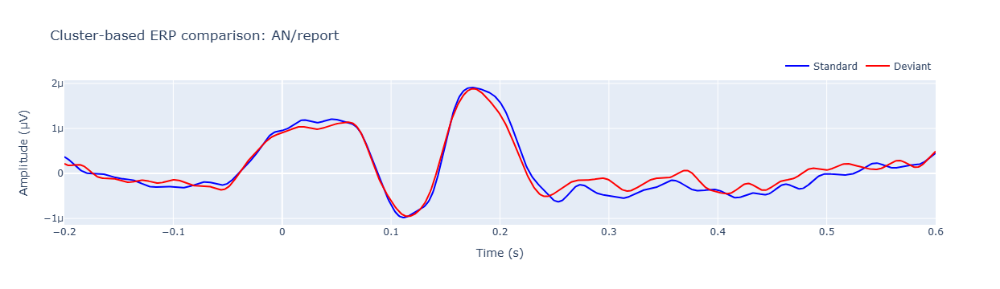

Using a threshold of 3.977779
stat_fun(H1): min=2.9807372048390846e-07 max=3.5317611958287394
Running initial clustering …
Found 0 clusters

Условие: impl/4 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



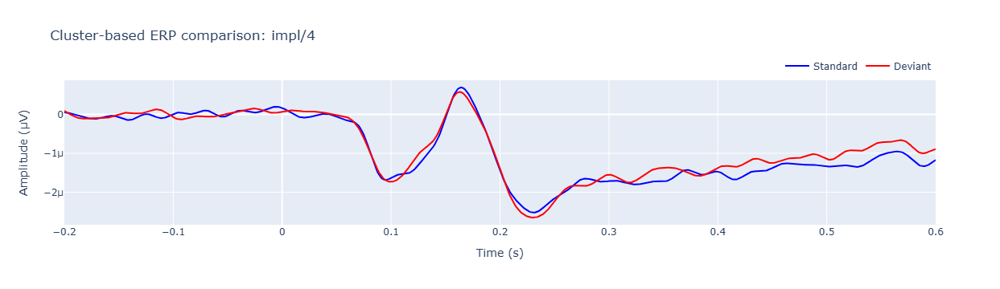

Using a threshold of 3.977779
stat_fun(H1): min=1.271796915564944e-05 max=5.413132731468004
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: impl/16 — Значимые кластеры (p < 0.05):


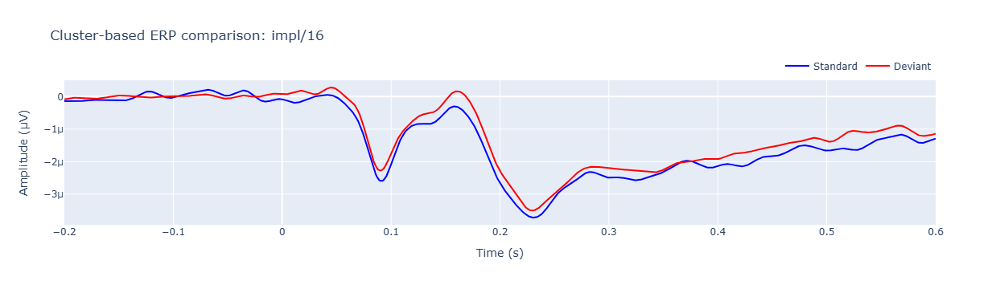

Using a threshold of 3.977779
stat_fun(H1): min=2.6719012174490074e-06 max=3.0008646669978205
Running initial clustering …
Found 0 clusters

Условие: expl/4 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



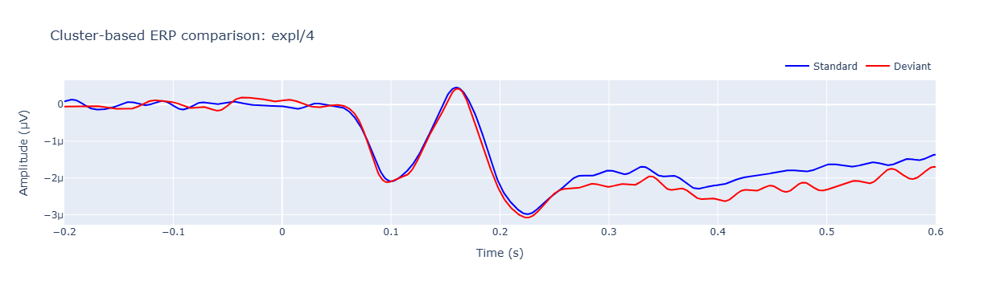

Using a threshold of 3.977779
stat_fun(H1): min=4.997875329772269e-06 max=3.545882664194204
Running initial clustering …
Found 0 clusters

Условие: expl/16 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



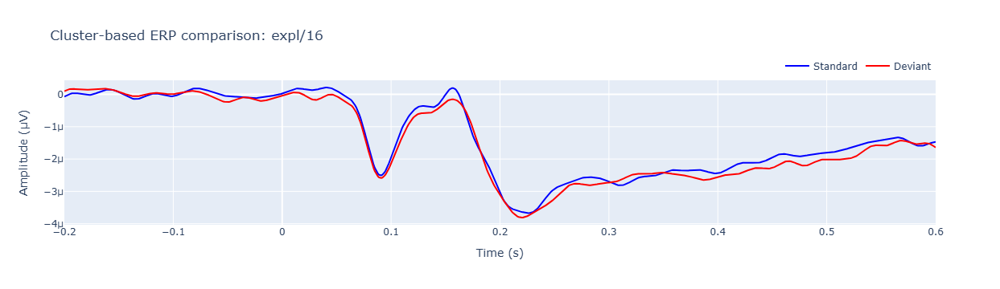

Using a threshold of 3.977779
stat_fun(H1): min=1.8484025920168624e-08 max=1.7387368686246685
Running initial clustering …
Found 0 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




Условие: report/4 — Значимые кластеры (p < 0.05):


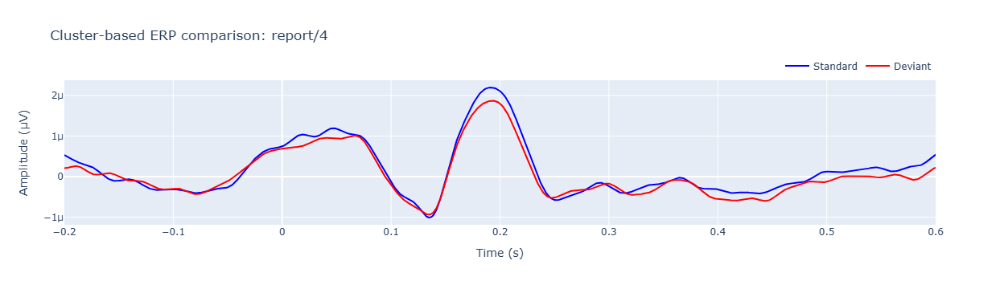

Using a threshold of 3.977779
stat_fun(H1): min=8.152870461752435e-07 max=3.86249389637841
Running initial clustering …
Found 0 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test




Условие: report/16 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



stat_fun(H1): min=5.014934190751811e-06 max=5.8067418319718005
Running initial clustering …
Found 2 clusters


  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: impl — Значимые кластеры (p < 0.05):


Using a threshold of 3.977779
stat_fun(H1): min=8.767938284651064e-07 max=3.209921869808317
Running initial clustering …
Found 0 clusters

Условие: expl — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779
stat_fun(H1): min=5.373941961228498e-07 max=2.1312773457513563
Running initial clustering …
Found 0 clusters

Условие: report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\4078771224.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



In [29]:

# Оусловия
conditions = [
    "HA/impl", "AN/impl", "HA/expl", "AN/expl", "HA/report", "AN/report",    
    "impl/4", "impl/16", "expl/4", "expl/16", "report/4", "report/16",
    "impl", "expl", "report"
]


for condition in conditions:
    standard_key = f"{condition}/standard"
    deviant_key = f"{condition}/deviant"

    if standard_key not in merged_erps or deviant_key not in merged_erps:
        print(f"Нет данных для {condition}")
        continue

    # Удаляем NaN
    standard_erps = [ev for ev in merged_erps[standard_key] if isinstance(ev, mne.Evoked)]
    deviant_erps = [ev for ev in merged_erps[deviant_key] if isinstance(ev, mne.Evoked)]

    if not standard_erps or not deviant_erps:
        print(f"Пустые данные для {condition}")
        continue

    ch_names = standard_erps[0].ch_names
    selected_indices = [i for i, ch in enumerate(ch_names) if ch in frontal_channels_central]

    if not selected_indices:
        print(f"Нет нужных каналов в {condition}")
        continue
        
    data_standard = np.array([ev.data[selected_indices, :] for ev in standard_erps])
    data_deviant = np.array([ev.data[selected_indices, :] for ev in deviant_erps])

    data_standard = data_standard.mean(axis = 1)
    data_deviant = data_deviant.mean(axis = 1)
    
    n_subjects, n_times = data_standard.shape
    times = standard_erps[0].times
    
    X = [
        data_deviant,
        data_standard
    ]

    # Кластерный t-тест
    T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
        X, n_permutations=2000, tail=0, threshold=None,
        out_type='mask', verbose=True
    )
    '''
    data_diff = data_deviant - data_standard  # shape: (subjects, channels, times)
    
    # Перестановочный кластерный одновыборочный t-тест (сравнение разности с 0)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_1samp_test(
        data_diff,
        n_permutations=2000,
        tail=0,  # двусторонний тест
        threshold=None,
        out_type='mask',
        verbose=True
    )
    '''
    # Результаты
    print(f"\nУсловие: {condition} — Значимые кластеры (p < 0.05):")
    for i_cl, cl in enumerate(clusters):
        if cluster_p_values[i_cl] < 0.05:
            mask = cl.reshape(n_times, n_channels).T
            time_mask = np.any(mask, axis=0)
            time_indices = np.where(time_mask)[0]
            if len(time_indices) == 0:
                continue
            start_time = times[time_indices[0]]
            end_time = times[time_indices[-1]]
            mean_t = np.mean(T_obs[time_mask])
            print(f"Кластер {i_cl}: p = {cluster_p_values[i_cl]:.4f}, "
                  f"mean t = {mean_t:.3f}, "
                  f"время = {start_time:.3f} – {end_time:.3f} с")

    # Визуализация
    if standard_key in grand_averages and deviant_key in grand_averages:
        std_data = grand_averages[standard_key].copy().pick_channels(frontal_channels_central).data.mean(axis=0)
        dev_data = grand_averages[deviant_key].copy().pick_channels(frontal_channels_central).data.mean(axis=0)

        fig = go.Figure()
        fig.add_trace(go.Scatter(x=times, y=std_data, mode='lines', name='Standard', line=dict(color='blue')))
        fig.add_trace(go.Scatter(x=times, y=dev_data, mode='lines', name='Deviant', line=dict(color='red')))

        for i_cl, cl in enumerate(clusters):
            if cluster_p_values[i_cl] < 0.05:
                mask = cl.reshape(n_times, n_channels).T
                time_mask = np.any(mask, axis=0)
                time_indices = np.where(time_mask)[0]
                if len(time_indices) == 0:
                    continue
                start_time = times[time_indices[0]]
                end_time = times[time_indices[-1]]
                mean_t = np.mean(T_obs[time_mask])
                ymin = min(std_data.min(), dev_data.min())
                ymax = max(std_data.max(), dev_data.max())

                fig.add_trace(go.Scatter(
                    x=[start_time, end_time, end_time, start_time, start_time],
                    y=[ymin, ymin, ymax, ymax, ymin],
                    fill="toself",
                    fillcolor="rgba(0, 255, 0, 0.2)",
                    line=dict(color='rgba(0,0,0,0)'),
                    name=f"Cluster {i_cl}: p={cluster_p_values[i_cl]:.3f}, t={mean_t:.2f}",
                    hoverinfo="skip"
                ))

        fig.update_layout(
            title=f'Cluster-based ERP comparison: {condition}',
            xaxis_title='Time (s)',
            yaxis_title='Amplitude (µV)',
            hovermode='x unified',
            legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
        )
        fig.show()


left channels

Using a threshold of 3.977779
stat_fun(H1): min=3.545748865440692e-06 max=5.978184767391093
Running initial clustering …
Found 3 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: HA/impl — Значимые кластеры (p < 0.05):


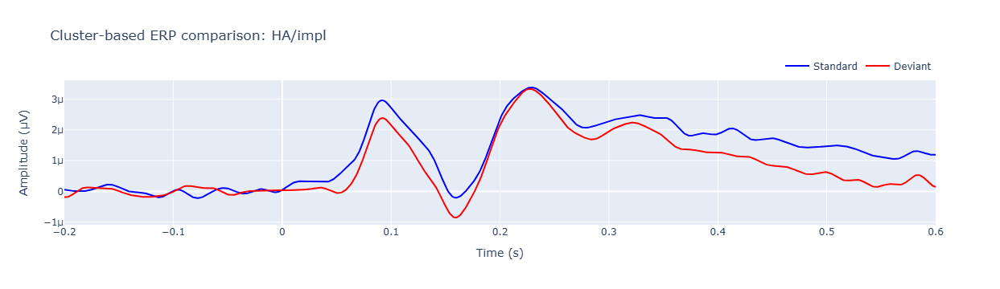

Using a threshold of 3.977779
stat_fun(H1): min=3.019108108763378e-06 max=7.52417946495149
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: AN/impl — Значимые кластеры (p < 0.05):


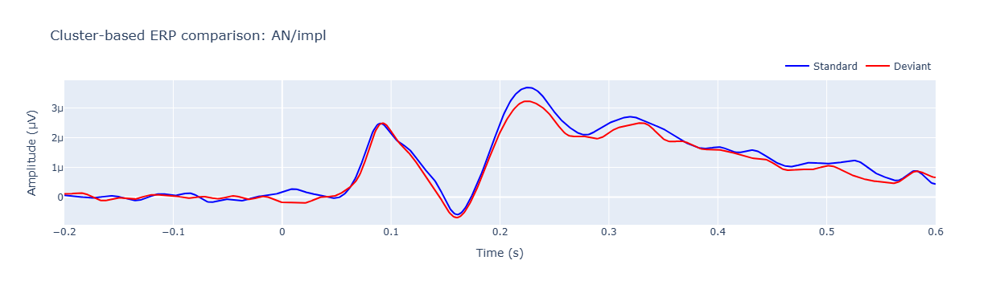

Using a threshold of 3.977779
stat_fun(H1): min=4.0720414738849653e-07 max=9.47213417068359
Running initial clustering …
Found 3 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: HA/expl — Значимые кластеры (p < 0.05):


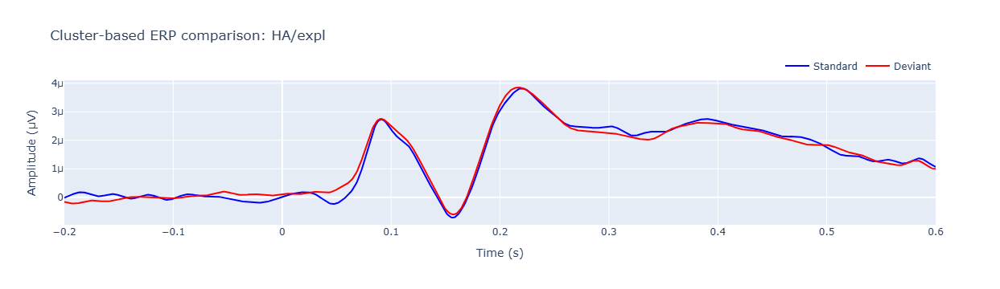

Using a threshold of 3.977779
stat_fun(H1): min=9.174166089717582e-07 max=9.105892716748816
Running initial clustering …
Found 3 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: AN/expl — Значимые кластеры (p < 0.05):


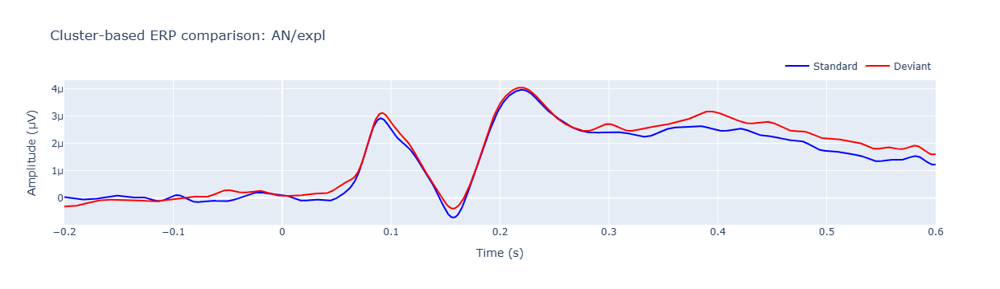

Using a threshold of 3.977779
stat_fun(H1): min=4.642456351425019e-06 max=2.202017092556178
Running initial clustering …
Found 0 clusters

Условие: HA/report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



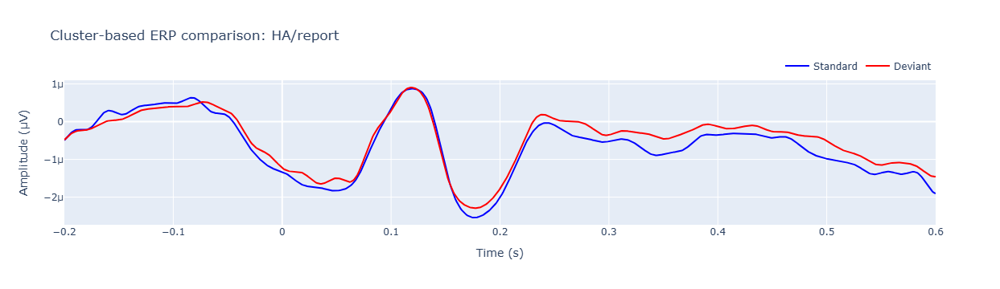

Using a threshold of 3.977779
stat_fun(H1): min=4.262868457509e-07 max=1.109223868250756
Running initial clustering …
Found 0 clusters

Условие: AN/report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



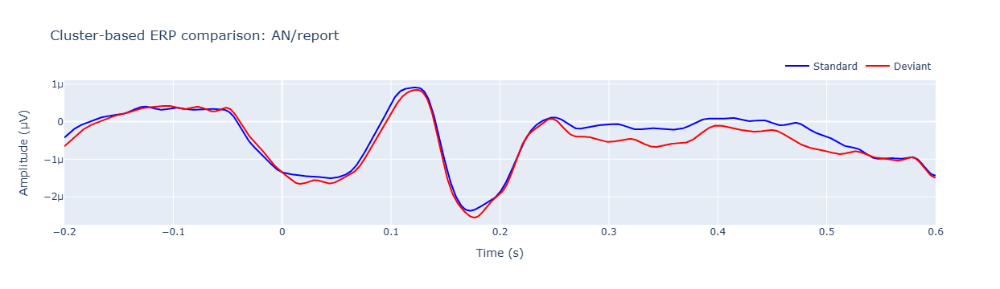

Using a threshold of 3.977779
stat_fun(H1): min=1.910219362521405e-06 max=3.336663024589263
Running initial clustering …


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Found 0 clusters

Условие: impl/4 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



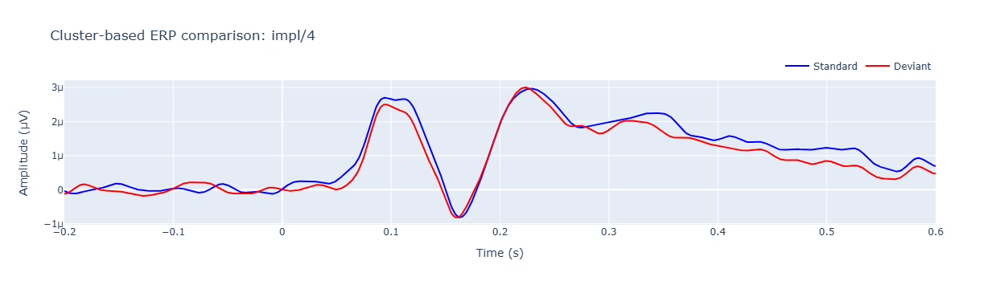

Using a threshold of 3.977779
stat_fun(H1): min=2.8156515598778773e-05 max=7.348701777763528
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: impl/16 — Значимые кластеры (p < 0.05):


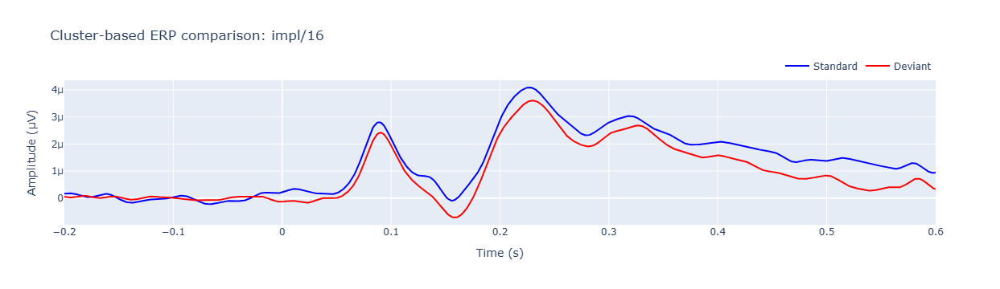

Using a threshold of 3.977779
stat_fun(H1): min=1.0004478811383252e-07 max=3.498439084224608
Running initial clustering …
Found 0 clusters

Условие: expl/4 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



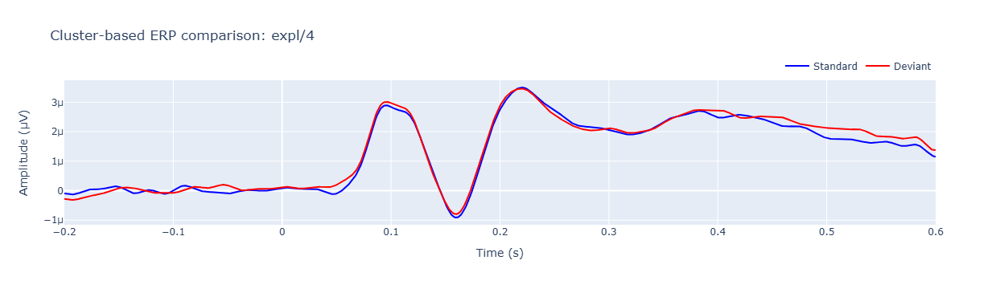

Using a threshold of 3.977779
stat_fun(H1): min=1.7815478274816608e-06 max=9.69004014862894
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: expl/16 — Значимые кластеры (p < 0.05):


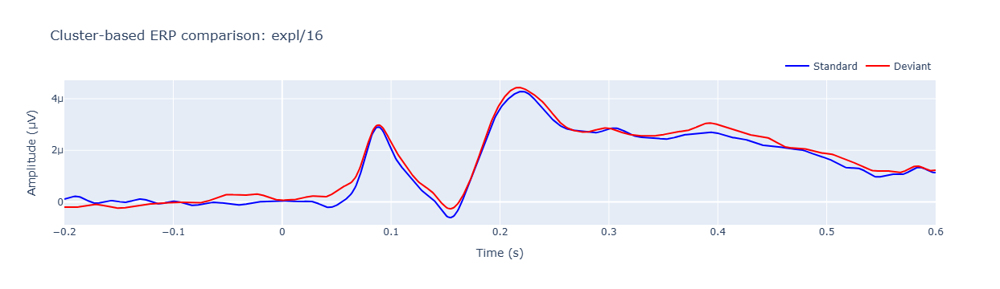

Using a threshold of 3.977779
stat_fun(H1): min=2.3330755962538826e-05 max=1.298719555175702
Running initial clustering …
Found 0 clusters

Условие: report/4 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



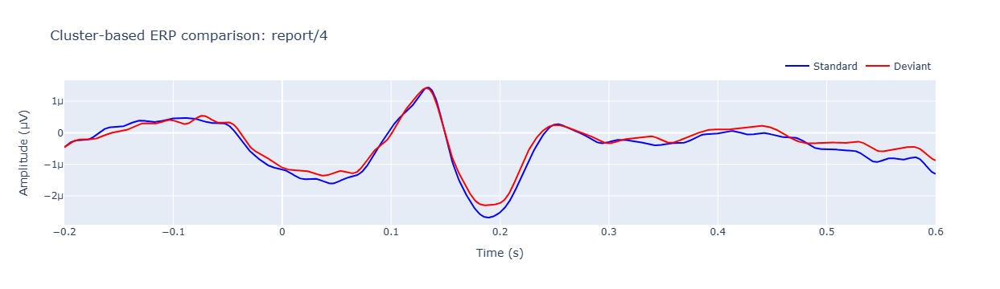

Using a threshold of 3.977779
stat_fun(H1): min=4.155472883373407e-07 max=1.1059007397556742
Running initial clustering …
Found 0 clusters

Условие: report/16 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



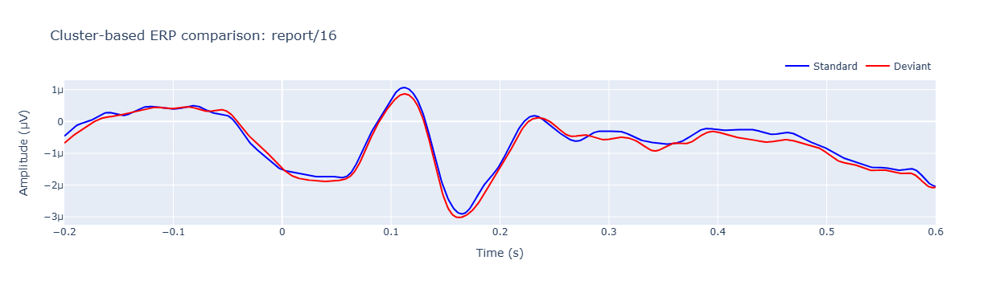

Using a threshold of 3.977779
stat_fun(H1): min=1.558997157171028e-09 max=8.427195558843561


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Running initial clustering …
Found 2 clusters


  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: impl — Значимые кластеры (p < 0.05):


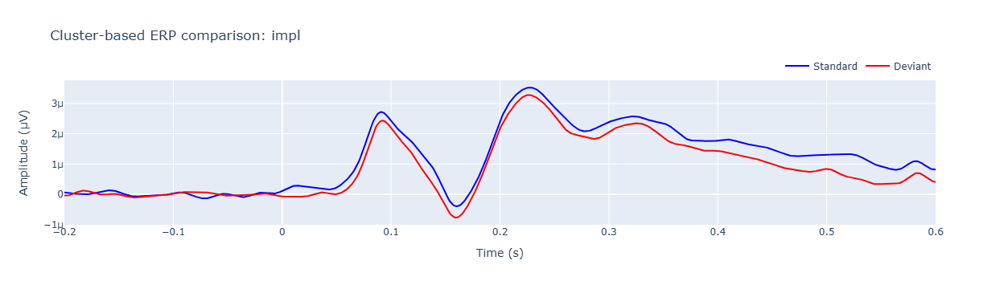

Using a threshold of 3.977779
stat_fun(H1): min=3.9012815695140175e-06 max=13.519461359922115
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: expl — Значимые кластеры (p < 0.05):


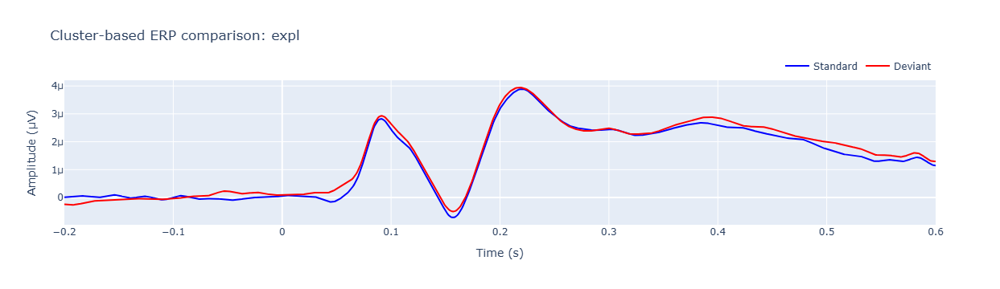

Using a threshold of 3.977779
stat_fun(H1): min=2.634916387804193e-07 max=1.4493119786588982
Running initial clustering …
Found 0 clusters

Условие: report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2314043575.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



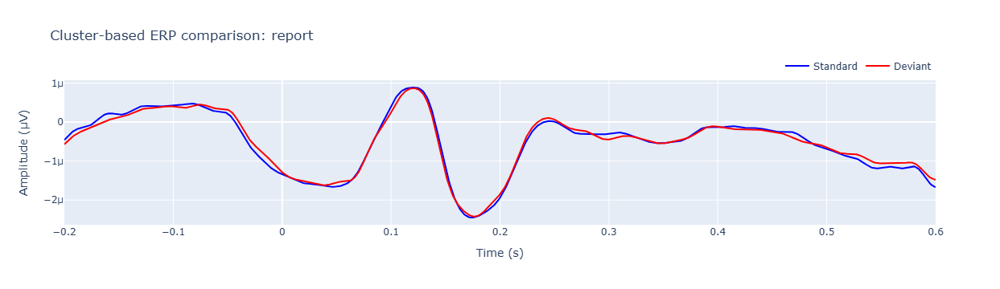

In [30]:
# Оусловия
conditions = [
    "HA/impl", "AN/impl", "HA/expl", "AN/expl", "HA/report", "AN/report",    
    "impl/4", "impl/16", "expl/4", "expl/16", "report/4", "report/16",
    "impl", "expl", "report"
]

for condition in conditions:
    standard_key = f"{condition}/standard"
    deviant_key = f"{condition}/deviant"

    if standard_key not in merged_erps or deviant_key not in merged_erps:
        print(f"Нет данных для {condition}")
        continue

    standard_erps = [ev for ev in merged_erps[standard_key] if isinstance(ev, mne.Evoked)]
    deviant_erps = [ev for ev in merged_erps[deviant_key] if isinstance(ev, mne.Evoked)]

    if not standard_erps or not deviant_erps:
        print(f"Пустые данные для {condition}")
        continue

    ch_names = standard_erps[0].ch_names
    selected_indices = [i for i, ch in enumerate(ch_names) if ch in left_channels]

    if not selected_indices:
        print(f"Нет нужных каналов в {condition}")
        continue

    data_standard = np.array([ev.data[selected_indices, :] for ev in standard_erps])
    data_deviant = np.array([ev.data[selected_indices, :] for ev in deviant_erps])

    data_standard = data_standard.mean(axis = 1)
    data_deviant = data_deviant.mean(axis = 1)
    
    n_subjects, n_times = data_standard.shape
    times = standard_erps[0].times
    
    X = [
        data_deviant,
        data_standard
    ]

    # Кластерный t-тест
    T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
        X, n_permutations=2000, tail=0, threshold=None,
        out_type='mask', verbose=True
    )
    '''
    data_diff = data_deviant - data_standard  # shape: (subjects, channels, times)
    
    # Перестановочный кластерный одновыборочный t-тест (сравнение разности с 0)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_1samp_test(
        data_diff,
        n_permutations=2000,
        tail=0,  # двусторонний тест
        threshold=None,
        out_type='mask',
        verbose=True
    )
    '''
    # Результаты
    print(f"\nУсловие: {condition} — Значимые кластеры (p < 0.05):")
    for i_cl, cl in enumerate(clusters):
        if cluster_p_values[i_cl] < 0.05:
            mask = cl.reshape(n_times, n_channels).T
            time_mask = np.any(mask, axis=0)
            time_indices = np.where(time_mask)[0]
            if len(time_indices) == 0:
                continue
            start_time = times[time_indices[0]]
            end_time = times[time_indices[-1]]
            mean_t = np.mean(T_obs[time_mask])
            print(f"Кластер {i_cl}: p = {cluster_p_values[i_cl]:.4f}, "
                  f"mean t = {mean_t:.3f}, "
                  f"время = {start_time:.3f} – {end_time:.3f} с")

    # Визуализация
    if standard_key in grand_averages and deviant_key in grand_averages:
        std_data = grand_averages[standard_key].copy().pick_channels(left_channels).data.mean(axis=0)
        dev_data = grand_averages[deviant_key].copy().pick_channels(left_channels).data.mean(axis=0)

        fig = go.Figure()
        fig.add_trace(go.Scatter(x=times, y=std_data, mode='lines', name='Standard', line=dict(color='blue')))
        fig.add_trace(go.Scatter(x=times, y=dev_data, mode='lines', name='Deviant', line=dict(color='red')))

        for i_cl, cl in enumerate(clusters):
            if cluster_p_values[i_cl] < 0.05:
                mask = cl.reshape(n_times, n_channels).T
                time_mask = np.any(mask, axis=0)
                time_indices = np.where(time_mask)[0]
                if len(time_indices) == 0:
                    continue
                start_time = times[time_indices[0]]
                end_time = times[time_indices[-1]]
                mean_t = np.mean(T_obs[time_mask])
                ymin = min(std_data.min(), dev_data.min())
                ymax = max(std_data.max(), dev_data.max())

                fig.add_trace(go.Scatter(
                    x=[start_time, end_time, end_time, start_time, start_time],
                    y=[ymin, ymin, ymax, ymax, ymin],
                    fill="toself",
                    fillcolor="rgba(0, 255, 0, 0.2)",
                    line=dict(color='rgba(0,0,0,0)'),
                    name=f"Cluster {i_cl}: p={cluster_p_values[i_cl]:.3f}, t={mean_t:.2f}",
                    hoverinfo="skip"
                ))

        fig.update_layout(
            title=f'Cluster-based ERP comparison: {condition}',
            xaxis_title='Time (s)',
            yaxis_title='Amplitude (µV)',
            hovermode='x unified',
            legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
        )
        fig.show()


right channels

Using a threshold of 3.977779
stat_fun(H1): min=1.827278955588671e-07 max=4.563979197026515
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: HA/impl — Значимые кластеры (p < 0.05):


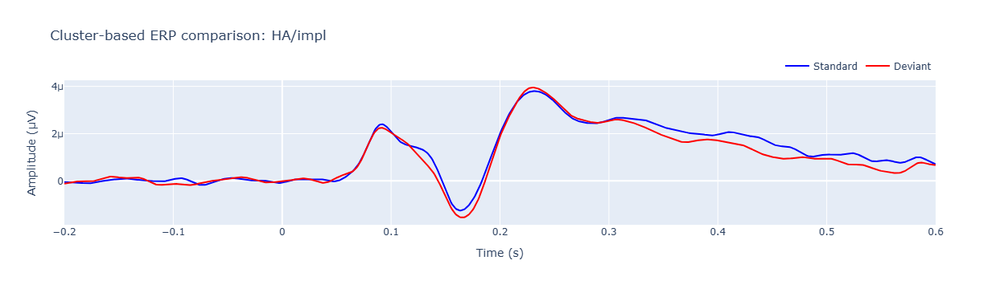

Using a threshold of 3.977779
stat_fun(H1): min=9.48189236281818e-05 max=6.8372249970765315
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: AN/impl — Значимые кластеры (p < 0.05):


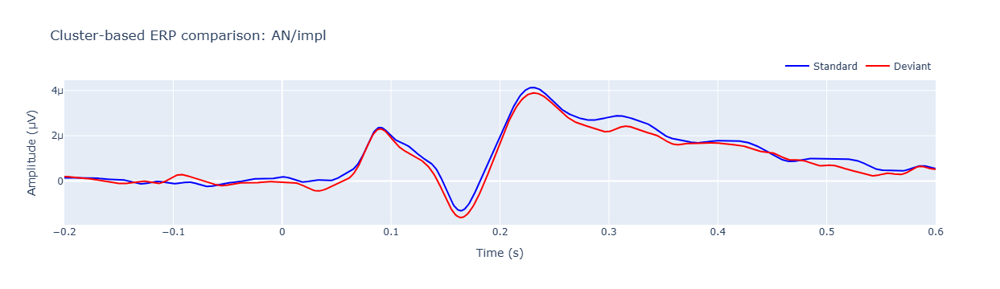

Using a threshold of 3.977779
stat_fun(H1): min=6.435766545630866e-07 max=7.945332954299246
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: HA/expl — Значимые кластеры (p < 0.05):


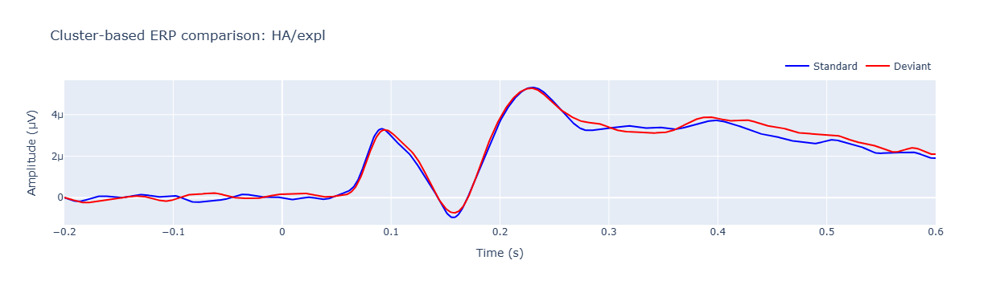

Using a threshold of 3.977779
stat_fun(H1): min=4.106101899750019e-08 max=3.8698535608749602
Running initial clustering …
Found 0 clusters

Условие: AN/expl — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



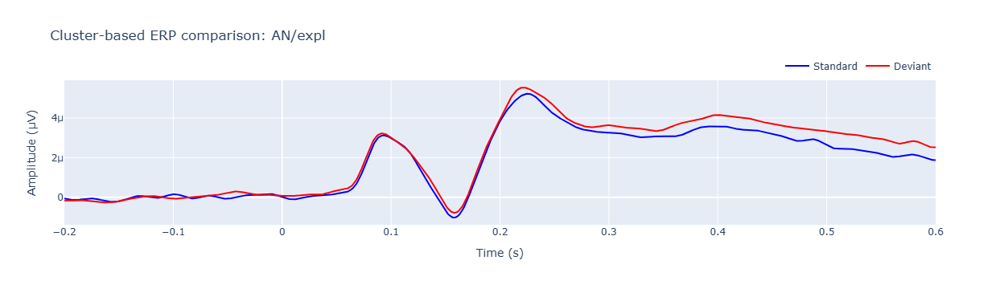

Using a threshold of 3.977779
stat_fun(H1): min=0.00011171102751383407 max=3.9264365005735526
Running initial clustering …
Found 0 clusters

Условие: HA/report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



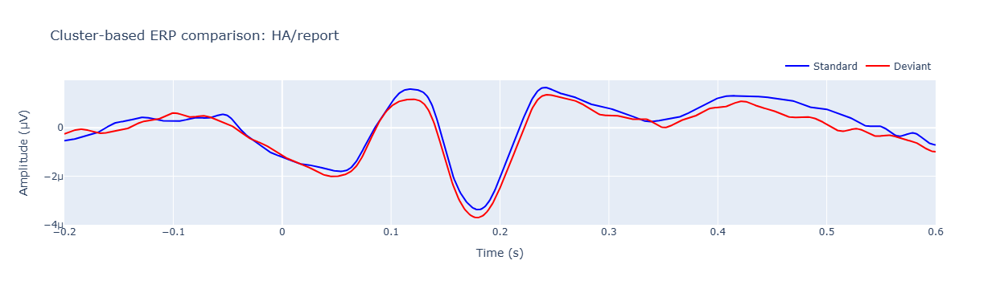

Using a threshold of 3.977779


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



stat_fun(H1): min=2.300814236861633e-07 max=1.9564617176383012
Running initial clustering …
Found 0 clusters

Условие: AN/report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



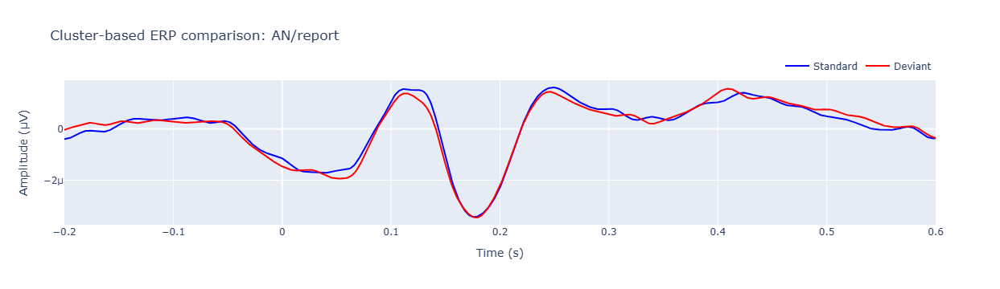

Using a threshold of 3.977779


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



stat_fun(H1): min=3.1236513636389107e-06 max=2.747852845844786
Running initial clustering …
Found 0 clusters

Условие: impl/4 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



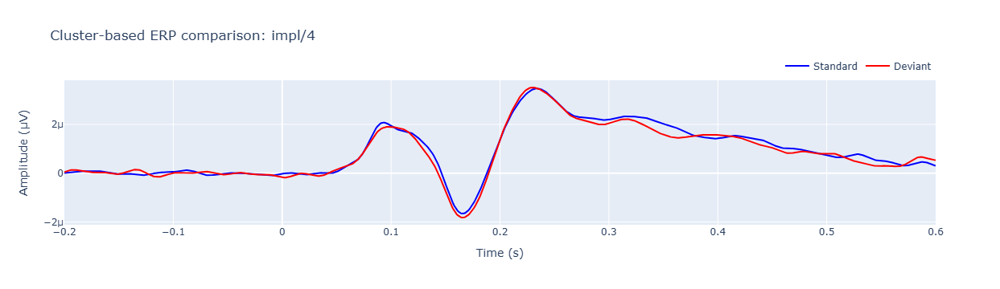

Using a threshold of 3.977779


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



stat_fun(H1): min=1.6986895511953413e-06 max=9.425253999351485
Running initial clustering …
Found 1 cluster


  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: impl/16 — Значимые кластеры (p < 0.05):


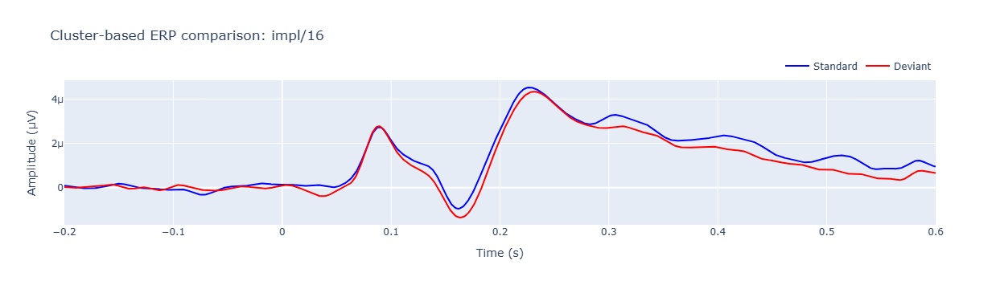

Using a threshold of 3.977779
stat_fun(H1): min=2.050897194072587e-05 max=4.5341203514283475
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: expl/4 — Значимые кластеры (p < 0.05):


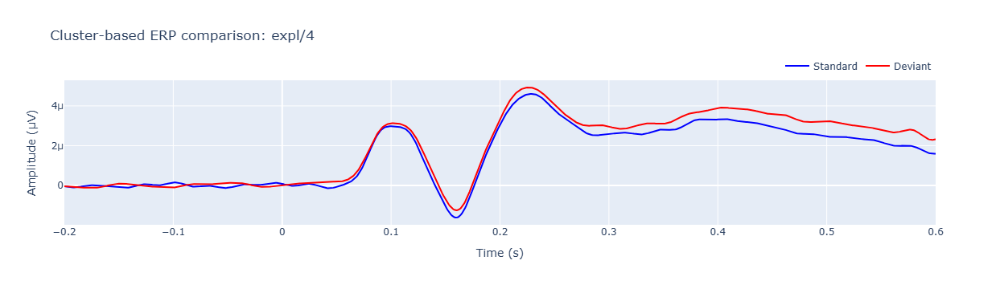

Using a threshold of 3.977779
stat_fun(H1): min=8.816636502722891e-07 max=4.909221998993887
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: expl/16 — Значимые кластеры (p < 0.05):


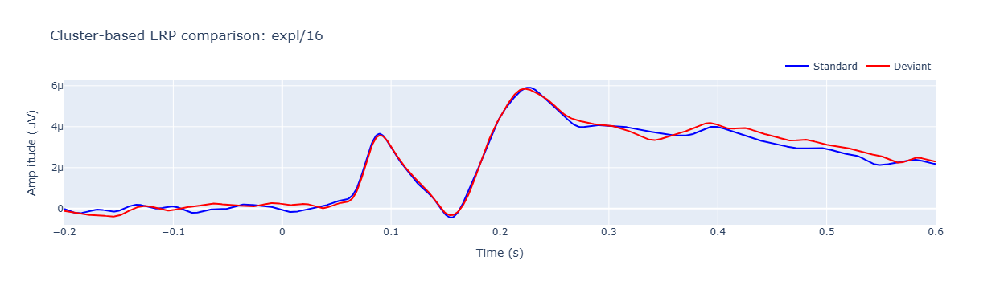

Using a threshold of 3.977779
stat_fun(H1): min=4.7544159631372924e-07 max=6.435373288089083
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: report/4 — Значимые кластеры (p < 0.05):


Using a threshold of 3.977779
stat_fun(H1): min=1.4153753464732392e-07 max=1.1651529551655162
Running initial clustering …
Found 0 clusters

Условие: report/16 — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779
stat_fun(H1): min=2.7448449029230206e-05 max=7.0187513456383215
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: impl — Значимые кластеры (p < 0.05):


Using a threshold of 3.977779
stat_fun(H1): min=5.8745379433829e-08 max=5.265136184700273
Running initial clustering …
Found 3 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Условие: expl — Значимые кластеры (p < 0.05):


Using a threshold of 3.977779
stat_fun(H1): min=1.9065859084906385e-07 max=2.0614671174567722
Running initial clustering …
Found 0 clusters

Условие: report — Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\3530736996.py:45: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



In [31]:
# Оусловия
conditions = [
    "HA/impl", "AN/impl", "HA/expl", "AN/expl", "HA/report", "AN/report",    
    "impl/4", "impl/16", "expl/4", "expl/16", "report/4", "report/16",
    "impl", "expl", "report"
]

for condition in conditions:
    standard_key = f"{condition}/standard"
    deviant_key = f"{condition}/deviant"

    if standard_key not in merged_erps or deviant_key not in merged_erps:
        print(f"Нет данных для {condition}")
        continue

    standard_erps = [ev for ev in merged_erps[standard_key] if isinstance(ev, mne.Evoked)]
    deviant_erps = [ev for ev in merged_erps[deviant_key] if isinstance(ev, mne.Evoked)]

    if not standard_erps or not deviant_erps:
        print(f"Пустые данные для {condition}")
        continue

    ch_names = standard_erps[0].ch_names
    selected_indices = [i for i, ch in enumerate(ch_names) if ch in right_channels]

    if not selected_indices:
        print(f"Нет нужных каналов в {condition}")
        continue

    data_standard = np.array([ev.data[selected_indices, :] for ev in standard_erps])
    data_deviant = np.array([ev.data[selected_indices, :] for ev in deviant_erps])

    data_standard = data_standard.mean(axis = 1)
    data_deviant = data_deviant.mean(axis = 1)
    
    n_subjects, n_times = data_standard.shape
    times = standard_erps[0].times
    
    X = [
        data_deviant,
        data_standard
    ]

    # Кластерный t-тест
    T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
        X, n_permutations=2000, tail=0, threshold=None,
        out_type='mask', verbose=True
    )
    '''
    data_diff = data_deviant - data_standard  # shape: (subjects, channels, times)
    
    # Перестановочный кластерный одновыборочный t-тест (сравнение разности с 0)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_1samp_test(
        data_diff,
        n_permutations=2000,
        tail=0,  # двусторонний тест
        threshold=None,
        out_type='mask',
        verbose=True
    )
    '''
    # Результаты
    print(f"\nУсловие: {condition} — Значимые кластеры (p < 0.05):")
    for i_cl, cl in enumerate(clusters):
        if cluster_p_values[i_cl] < 0.05:
            mask = cl.reshape(n_times, n_channels).T
            time_mask = np.any(mask, axis=0)
            time_indices = np.where(time_mask)[0]
            if len(time_indices) == 0:
                continue
            start_time = times[time_indices[0]]
            end_time = times[time_indices[-1]]
            mean_t = np.mean(T_obs[time_mask])
            print(f"Кластер {i_cl}: p = {cluster_p_values[i_cl]:.4f}, "
                  f"mean t = {mean_t:.3f}, "
                  f"время = {start_time:.3f} – {end_time:.3f} с")

    # Визуализация
    if standard_key in grand_averages and deviant_key in grand_averages:
        std_data = grand_averages[standard_key].copy().pick_channels(right_channels).data.mean(axis=0)
        dev_data = grand_averages[deviant_key].copy().pick_channels(right_channels).data.mean(axis=0)

        fig = go.Figure()
        fig.add_trace(go.Scatter(x=times, y=std_data, mode='lines', name='Standard', line=dict(color='blue')))
        fig.add_trace(go.Scatter(x=times, y=dev_data, mode='lines', name='Deviant', line=dict(color='red')))

        for i_cl, cl in enumerate(clusters):
            if cluster_p_values[i_cl] < 0.05:
                mask = cl.reshape(n_times, n_channels).T
                time_mask = np.any(mask, axis=0)
                time_indices = np.where(time_mask)[0]
                if len(time_indices) == 0:
                    continue
                start_time = times[time_indices[0]]
                end_time = times[time_indices[-1]]
                mean_t = np.mean(T_obs[time_mask])
                ymin = min(std_data.min(), dev_data.min())
                ymax = max(std_data.max(), dev_data.max())

                fig.add_trace(go.Scatter(
                    x=[start_time, end_time, end_time, start_time, start_time],
                    y=[ymin, ymin, ymax, ymax, ymin],
                    fill="toself",
                    fillcolor="rgba(0, 255, 0, 0.2)",
                    line=dict(color='rgba(0,0,0,0)'),
                    name=f"Cluster {i_cl}: p={cluster_p_values[i_cl]:.3f}, t={mean_t:.2f}",
                    hoverinfo="skip"
                ))

        fig.update_layout(
            title=f'Cluster-based ERP comparison: {condition}',
            xaxis_title='Time (s)',
            yaxis_title='Amplitude (µV)',
            hovermode='x unified',
            legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
        )
        fig.show()


сравнение условий по эмоциям

Using a threshold of 3.977779
stat_fun(H1): min=7.79871939374201e-05 max=3.0346178233843815
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



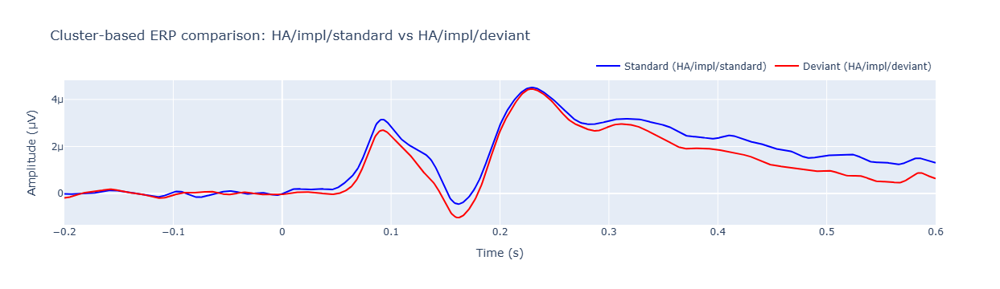

Using a threshold of 3.977779
stat_fun(H1): min=2.5337978659323538e-05 max=7.031718258048333
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


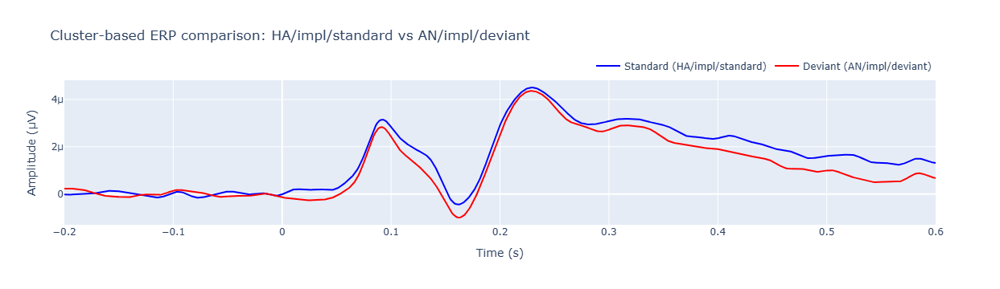

Using a threshold of 3.977779
stat_fun(H1): min=1.688719660511127e-08 max=2.08477232818387
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



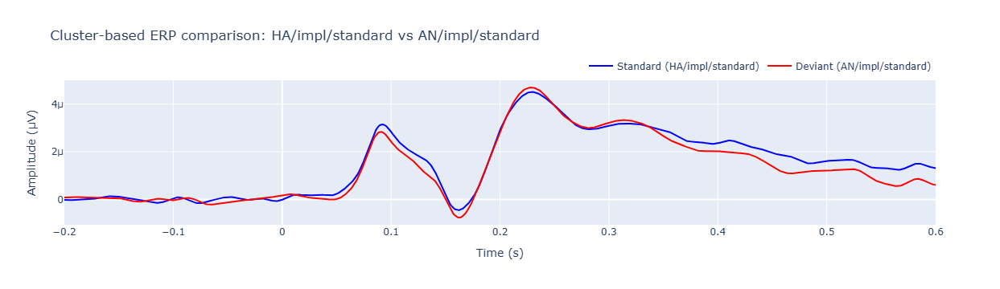

Using a threshold of 3.977779
stat_fun(H1): min=4.753688163301286e-09 max=10.469041849093266
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


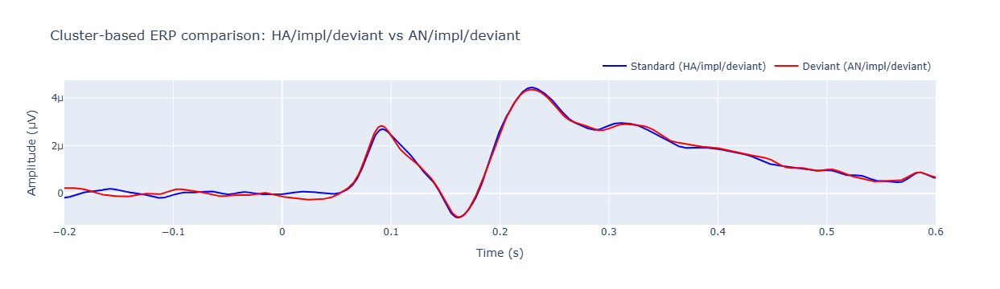

Using a threshold of 3.977779
stat_fun(H1): min=1.4705545769951902e-05 max=4.62260380590027
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


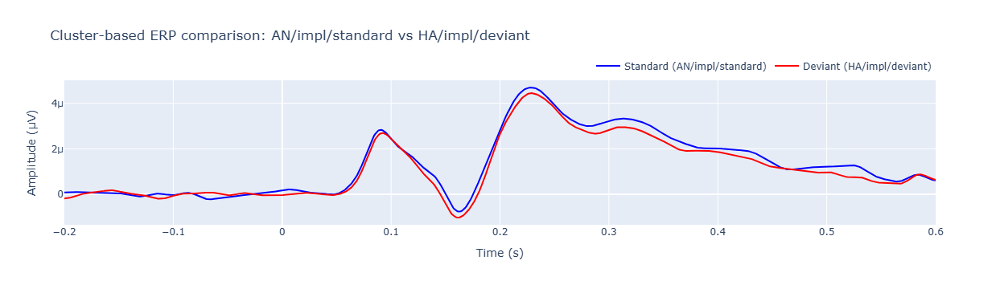

Using a threshold of 3.977779
stat_fun(H1): min=2.356792944663928e-06 max=6.457325687025054
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


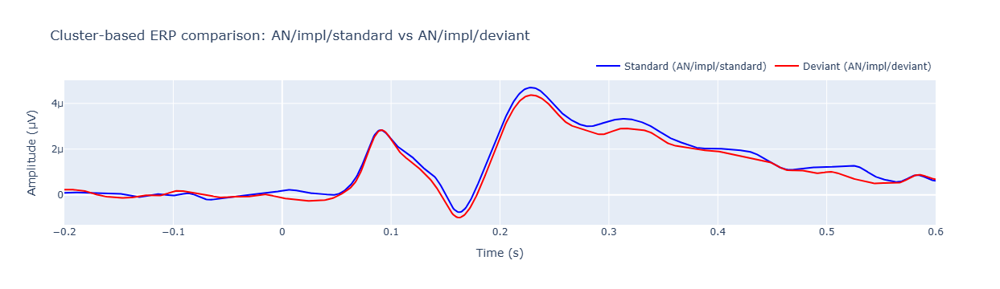

Using a threshold of 3.977779
stat_fun(H1): min=1.1625261645338795e-06 max=6.5709514874445425
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


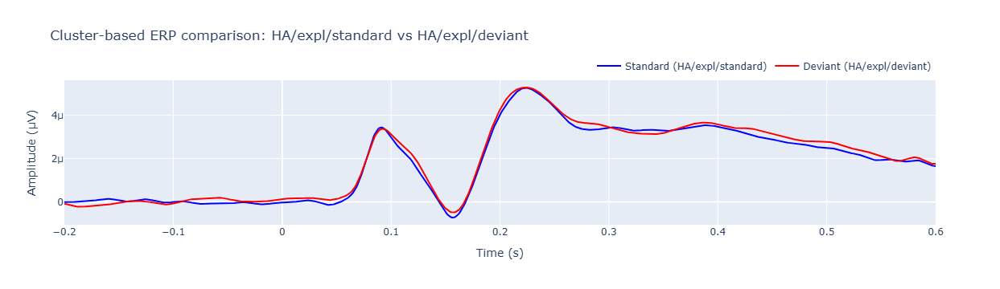

Using a threshold of 3.977779
stat_fun(H1): min=9.100347366383424e-05 max=7.8313162925595625
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


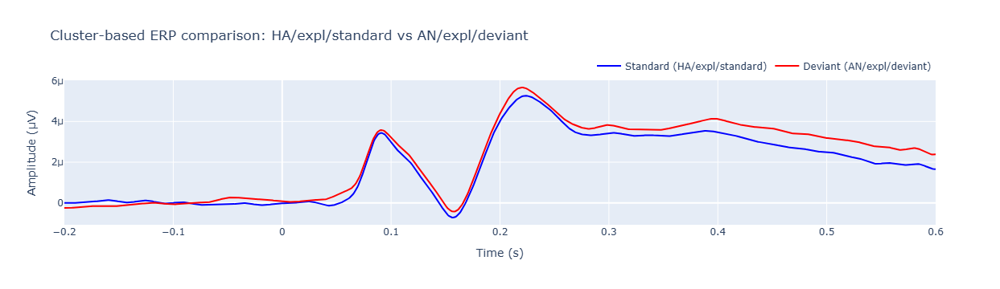

Using a threshold of 3.977779
stat_fun(H1): min=3.326829029841679e-10 max=6.040564456659695
Running initial clustering …
Found 1 cluster


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


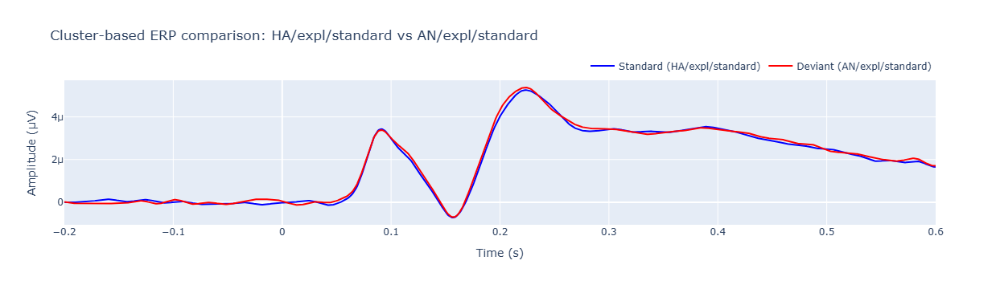

Using a threshold of 3.977779
stat_fun(H1): min=1.7483435830241715e-08 max=3.213766070478066
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



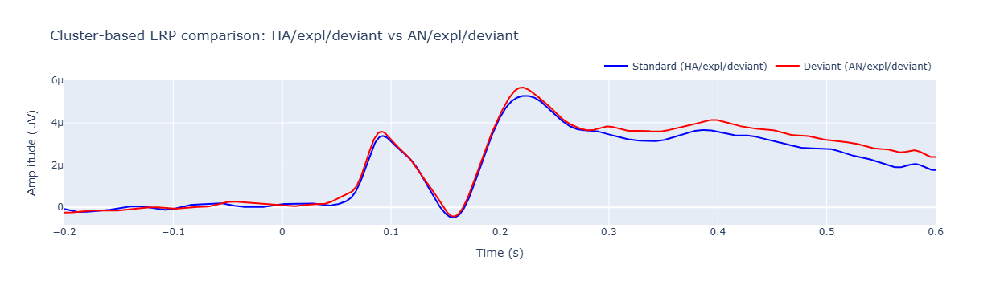

Using a threshold of 3.977779
stat_fun(H1): min=8.665557779575319e-07 max=6.657067868516408
Running initial clustering …
Found 3 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


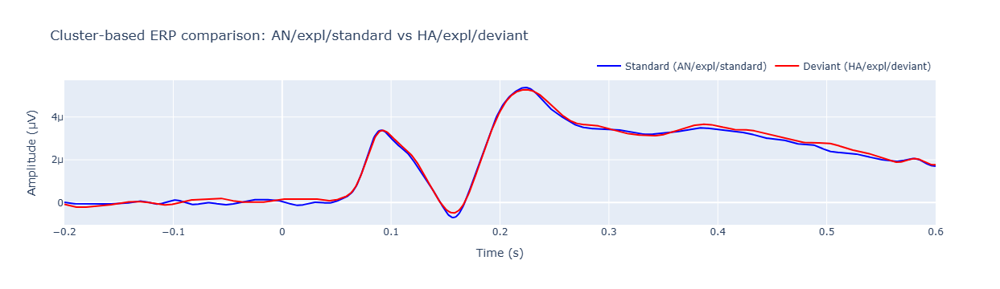

Using a threshold of 3.977779
stat_fun(H1): min=2.647557902340744e-06 max=6.771854702858659
Running initial clustering …
Found 2 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]


Значимые кластеры (p < 0.05):


Using a threshold of 3.977779
stat_fun(H1): min=1.9843187328886267e-07 max=3.2201270459202367
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779
stat_fun(H1): min=3.560072188281138e-07 max=1.8496854644758844
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



stat_fun(H1): min=1.4704332748475004e-06 max=1.3533297618637379
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



stat_fun(H1): min=1.7717522877026842e-07 max=1.4956399657867663
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779
stat_fun(H1): min=2.3765852409789882e-05 max=3.0084660352060504
Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



Using a threshold of 3.977779
stat_fun(H1): min=2.1805744224829326e-08 max=0.6599490170870665


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Running initial clustering …
Found 0 clusters

Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2673952513.py:63: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv



In [32]:
# Сравниваемые пары условий
comparisons = [
    ("HA/impl/standard", "HA/impl/deviant"),
    ("HA/impl/standard", "AN/impl/deviant"),
    ("HA/impl/standard", "AN/impl/standard"),
    ("HA/impl/deviant", "AN/impl/deviant"),
    ("AN/impl/standard", "HA/impl/deviant"),
    ("AN/impl/standard", "AN/impl/deviant"),
    
    ("HA/expl/standard", "HA/expl/deviant"),
    ("HA/expl/standard", "AN/expl/deviant"),
    ("HA/expl/standard", "AN/expl/standard"),
    ("HA/expl/deviant", "AN/expl/deviant"),
    ("AN/expl/standard", "HA/expl/deviant"),
    ("AN/expl/standard", "AN/expl/deviant"),
    
    ("HA/report/standard", "HA/report/deviant"),
    ("HA/report/standard", "AN/report/deviant"),
    ("HA/report/standard", "AN/report/standard"),
    ("HA/report/deviant", "AN/report/deviant"),
    ("AN/report/standard", "HA/report/deviant"),
    ("AN/report/standard", "AN/report/deviant")
]




for standard_key, deviant_key in comparisons:
    # Получение данных для каждого из условий
    standard_erps = merged_erps[standard_key]
    deviant_erps = merged_erps[deviant_key]
    
    # Преобразование данных в массивы (с учетом формы: subjects x channels x times)
    data_standard = np.array([evoked.data for evoked in standard_erps])  # shape: subjects x channels x times
    data_deviant  = np.array([evoked.data for evoked in deviant_erps])
    ch_names = standard_erps[0].ch_names
    
    selected_indices = [i for i, ch in enumerate(ch_names) if ch in occipital_parietal_channels]

    if not selected_indices:
        print(f"Нет нужных каналов в {condition}")
        continue

    data_standard = np.array([ev.data[selected_indices, :] for ev in standard_erps])
    data_deviant = np.array([ev.data[selected_indices, :] for ev in deviant_erps])

    n_subjects, n_channels, n_times = data_standard.shape
    times = standard_erps[0].times  # временные метки
    

    data_standard = data_standard.mean(axis = 1)
    data_deviant = data_deviant.mean(axis = 1)
    
    n_subjects, n_times = data_standard.shape
    times = standard_erps[0].times
    
    X = [
        data_deviant,
        data_standard
    ]

    # Кластерный t-тест
    T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
        X, n_permutations=2000, tail=0, threshold=None,
        out_type='mask', verbose=True
    )


    
    '''
    data_diff = data_deviant - data_standard  # shape: (subjects, channels, times)
    
    # Перестановочный кластерный одновыборочный t-тест (сравнение разности с 0)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_1samp_test(
        data_diff,
        n_permutations=2000,
        tail=0,  # двусторонний тест
        threshold=None,
        out_type='mask',
        verbose=True
    ) 
    '''
    # --- Анализ результатов ---
    print("\nЗначимые кластеры (p < 0.05):")
    for i_cl, cl in enumerate(clusters):
        if cluster_p_values[i_cl] < 0.05:
            mask = cl.reshape(n_times, n_channels).T
            time_points = np.any(mask, axis=0)
            time_indices = np.where(time_points)[0]
            if len(time_indices) == 0:
                continue
            start_time = times[time_indices[0]]
            end_time = times[time_indices[-1]]
            mean_t = np.mean(T_obs[time_points])
            print(f"Кластер {i_cl}: p = {cluster_p_values[i_cl]:.4f}, "
                  f"mean t = {mean_t:.3f}, "
                  f"время = {start_time:.3f} – {end_time:.3f} с")
    
    # --- График на основе grand average ---
    # --- График на основе grand average (только по выбранным каналам) ---
    if standard_key not in grand_averages or deviant_key not in grand_averages:
        print(f"Нет данных для {standard_key} и {deviant_key}")
    else:
        # Берём только нужные каналы
        std_evoked = grand_averages[standard_key].copy().pick_channels(occipital_parietal_channels)
        dev_evoked = grand_averages[deviant_key].copy().pick_channels(occipital_parietal_channels)
    
        times = std_evoked.times
        std_data = std_evoked.data.mean(axis=0)  # усреднение по каналам
        dev_data = dev_evoked.data.mean(axis=0)
    
        data_values = {
            f"Standard ({standard_key})": std_data,
            f"Deviant ({deviant_key})": dev_data
        }
    
        fig = go.Figure()
        colors = ['blue', 'red']
    
        for idx, (label, values) in enumerate(data_values.items()):
            fig.add_trace(go.Scatter(
                x=times,
                y=values,
                mode='lines',
                name=label,
                line=dict(color=colors[idx])
            ))
    
        # --- Подсветка значимых кластеров ---
        for i_c, cl in enumerate(clusters):
            if cluster_p_values[i_c] < 0.05:
                mask = cl.reshape(n_times, n_channels).T
                time_mask = np.any(mask, axis=0)
                time_indices = np.where(time_mask)[0]
                if len(time_indices) == 0:
                    continue
    
                start_time = times[time_indices[0]]
                end_time = times[time_indices[-1]]
                cluster_t_vals = T_obs[time_mask]
                mean_t = np.mean(cluster_t_vals)
    
                fig.add_trace(go.Scatter(
                    x=[start_time, end_time, end_time, start_time, start_time],
                    y=[min(std_data.min(), dev_data.min())] * 2 +
                      [max(std_data.max(), dev_data.max())] * 2,
                    fill="toself",
                    fillcolor="rgba(0, 255, 0, 0.2)",
                    line=dict(color='rgba(0,0,0,0)'),
                    name=f"Cluster {i_c}: p={cluster_p_values[i_c]:.3f}, t={mean_t:.2f}",
                    hoverinfo="skip"
                ))
    
        fig.update_layout(
            title=f'Cluster-based ERP comparison: {standard_key} vs {deviant_key}',
            xaxis_title='Time (s)',
            yaxis_title='Amplitude (µV)',
            hovermode='x unified',
            legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
        )
    
        fig.show()



сравнение по условиям

Using a threshold of 3.977779
stat_fun(H1): min=6.607423455392864e-05 max=7.9752998700481035
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2480676950.py:52: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]

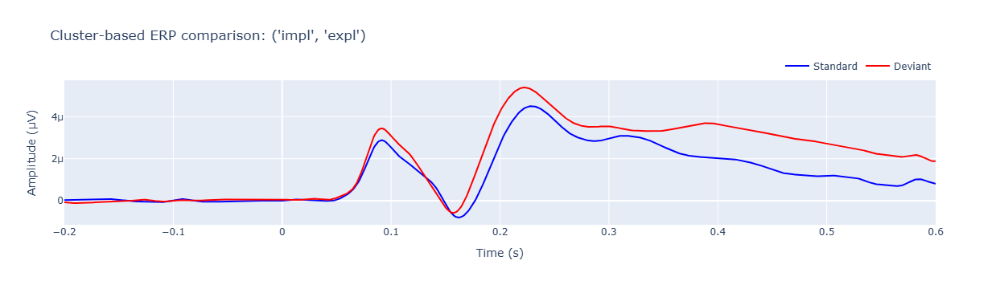

Using a threshold of 3.977779
stat_fun(H1): min=0.0001305427351727628 max=92.41684123486107
Running initial clustering …
Found 3 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2480676950.py:52: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]

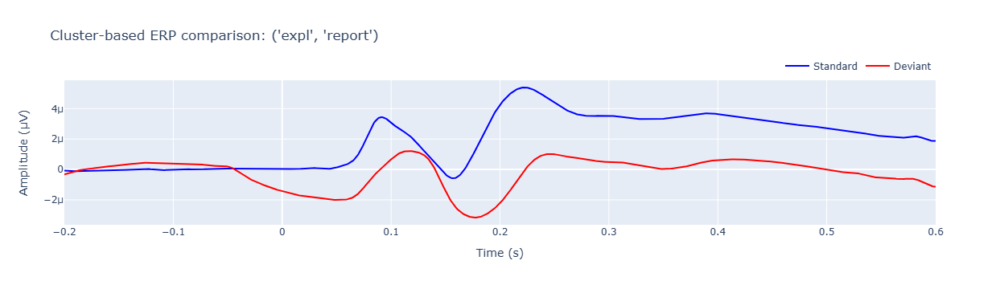

Using a threshold of 3.977779
stat_fun(H1): min=0.0007802817827959636 max=88.741623822211
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2480676950.py:52: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]

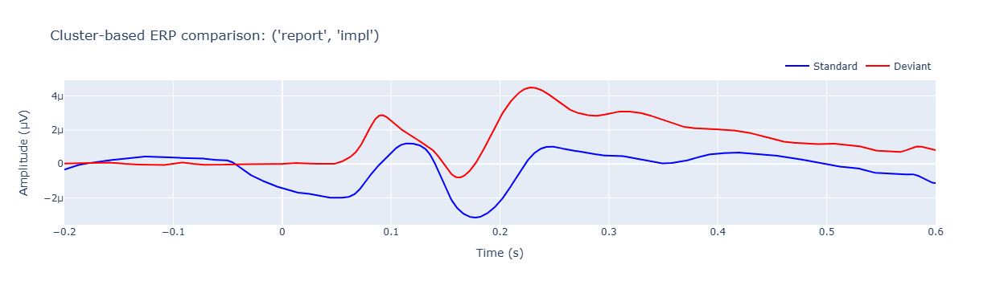

Using a threshold of 3.977779
stat_fun(H1): min=3.82657017811003e-05 max=6.700572888480422
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2480676950.py:52: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]

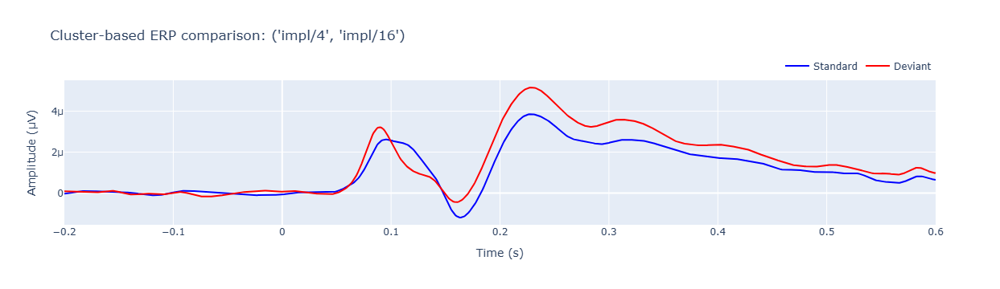

Using a threshold of 3.977779
stat_fun(H1): min=5.0751425392013236e-08 max=7.434013983382786
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2480676950.py:52: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]

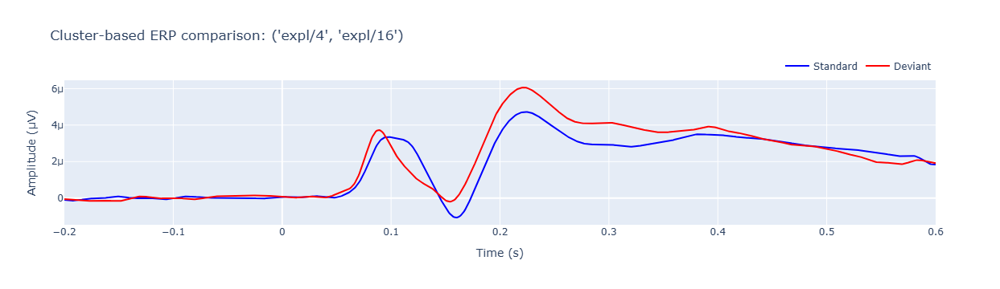

Using a threshold of 3.977779
stat_fun(H1): min=3.1094678177714274e-05 max=13.94304651618517
Running initial clustering …
Found 4 clusters


C:\Users\user\AppData\Local\Temp\ipykernel_16112\2480676950.py:52: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



  0%|          | Permuting : 0/1999 [00:00<?,       ?it/s]

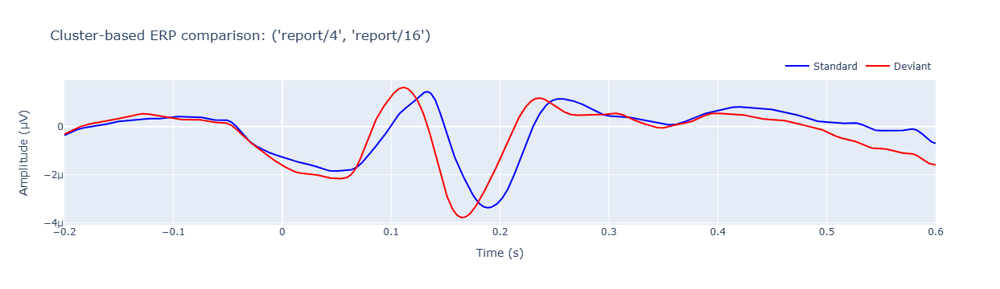

In [45]:
# Оусловия
comparisons = [
    ("impl", "expl"),
    ("expl", "report"),
    ("report", "impl"),
    ("impl/4", "impl/16"),
    ("expl/4", "expl/16"),
    ("report/4", "report/16")

]


for condition in comparisons:
    standard_key = condition[0]
    deviant_key = condition[1]

    if standard_key not in erps or deviant_key not in merged_erps:
        print(f"Нет данных для {condition}")
        continue

    # Удаляем NaN
    standard_erps = [ev for ev in merged_erps[standard_key] if isinstance(ev, mne.Evoked)]
    deviant_erps = [ev for ev in merged_erps[deviant_key] if isinstance(ev, mne.Evoked)]

    if not standard_erps or not deviant_erps:
        print(f"Пустые данные для {condition}")
        continue

    ch_names = standard_erps[0].ch_names
    selected_indices = [i for i, ch in enumerate(ch_names) if ch in occipital_parietal_channels]

    if not selected_indices:
        print(f"Нет нужных каналов в {condition}")
        continue

    
    data_standard = np.array([ev.data[selected_indices, :] for ev in standard_erps])
    data_deviant = np.array([ev.data[selected_indices, :] for ev in deviant_erps])

    data_standard = data_standard.mean(axis = 1)
    data_deviant = data_deviant.mean(axis = 1)
    
    n_subjects, n_times = data_standard.shape
    times = standard_erps[0].times
    
    X = [
        data_deviant,
        data_standard
    ]

    # Кластерный t-тест
    T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
        X, n_permutations=2000, tail=0, threshold=None,
        out_type='mask', verbose=True
    )

    '''
    
    data_diff = data_deviant - data_standard  # shape: (subjects, channels, times)
    
    # Перестановочный кластерный одновыборочный t-тест (сравнение разности с 0)
    T_obs, clusters, cluster_p_values, H0 = mne.stats.permutation_cluster_1samp_test(
        data_diff,
        n_permutations=2000,
        tail=0,  # двусторонний тест
        threshold=None,
        out_type='mask',
        verbose=True
    )
    '''

    # Результаты
    '''
    print(f"\nУсловие: {condition} — Значимые кластеры (p < 0.05):")
    for i_cl, cl in enumerate(clusters):
        if cluster_p_values[i_cl] < 0.05:
            mask = cl.reshape(n_times, n_channels).T
            time_mask = np.any(mask, axis=0)
            time_indices = np.where(time_mask)[0]
            if len(time_indices) == 0:
                continue
            start_time = times[time_indices[0]]
            end_time = times[time_indices[-1]]
            mean_t = np.mean(T_obs[time_mask])
            print(f"Кластер {i_cl}: p = {cluster_p_values[i_cl]:.4f}, "
                  f"mean t = {mean_t:.3f}, "
                  f"время = {start_time:.3f} – {end_time:.3f} с")
        '''

    # Визуализация
    if standard_key in grand_averages and deviant_key in grand_averages:
        std_data = grand_averages[standard_key].copy().pick_channels(occipital_parietal_channels).data.mean(axis=0)
        dev_data = grand_averages[deviant_key].copy().pick_channels(occipital_parietal_channels).data.mean(axis=0)

        fig = go.Figure()
        fig.add_trace(go.Scatter(x=times, y=std_data, mode='lines', name='Standard', line=dict(color='blue')))
        fig.add_trace(go.Scatter(x=times, y=dev_data, mode='lines', name='Deviant', line=dict(color='red')))
        '''
        for i_cl, cl in enumerate(clusters):
            if cluster_p_values[i_cl] < 0.05:
                mask = cl.reshape(n_times, n_channels).T
                time_mask = np.any(mask, axis=0)
                time_indices = np.where(time_mask)[0]
                if len(time_indices) == 0:
                    continue
                start_time = times[time_indices[0]]
                end_time = times[time_indices[-1]]
                mean_t = np.mean(T_obs[time_mask])
                ymin = min(std_data.min(), dev_data.min())
                ymax = max(std_data.max(), dev_data.max())

                fig.add_trace(go.Scatter(
                    x=[start_time, end_time, end_time, start_time, start_time],
                    y=[ymin, ymin, ymax, ymax, ymin],
                    fill="toself",
                    fillcolor="rgba(0, 255, 0, 0.2)",
                    line=dict(color='rgba(0,0,0,0)'),
                    name=f"Cluster {i_cl}: p={cluster_p_values[i_cl]:.3f}, t={mean_t:.2f}",
                    hoverinfo="skip"
                ))
            '''
        fig.update_layout(
            title=f'Cluster-based ERP comparison: {condition}',
            xaxis_title='Time (s)',
            yaxis_title='Amplitude (µV)',
            hovermode='x unified',
            legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
        )
        fig.show()


In [40]:
cl

(slice(568, 783, None),)

по каналам

In [174]:
# Условия
conditions = [
    "HA/impl", "AN/impl", "HA/expl", "AN/expl", "HA/report", "AN/report",    
    "impl/4", "impl/16", "expl/4", "expl/16", "report/4", "report/16",
    "impl", "expl", "report"
]
for condition in conditions:
    standard_key = f"{condition}/standard"
    deviant_key = f"{condition}/deviant"

    if standard_key not in merged_erps or deviant_key not in merged_erps:
        print(f"Нет данных для {condition}")
        continue

    standard_erps = merged_erps[standard_key]
    deviant_erps = merged_erps[deviant_key]
    
    # Убираем np.nan и другие не-Evoked
    standard_erps = [evoked for evoked in standard_erps if isinstance(evoked, mne.Evoked)]
    deviant_erps = [evoked for evoked in deviant_erps if isinstance(evoked, mne.Evoked)]
    

    # Получаем каналы и индексы из первого Evoked (гарантированно соответствуют данным)
    channel_names = standard_erps[0].ch_names
    channel_indices = [i for i, ch in enumerate(channel_names) if ch in all_channels]

    data_standard = np.array([evoked.data for evoked in standard_erps])
    data_deviant = np.array([evoked.data for evoked in deviant_erps])

    
    times = standard_erps[0].times
    n_subjects = data_standard.shape[0]

    

    

    for ch_idx in channel_indices:
        ch_name = channel_names[ch_idx]
        print(f"\n--- Анализ {condition} | Канал: {ch_name} ---")

        X = [
            data_deviant[:, ch_idx, :],  # shape: (subjects, times)
            data_standard[:, ch_idx, :]
        ]

        T_obs, clusters, cluster_p_values, H0 = permutation_cluster_test(
            X,
            n_permutations=2000,
            tail=0,
            threshold=None,
            out_type='mask',
            verbose=False
        )


        # --- Анализ результатов ---
        print("Значимые кластеры (p < 0.05):")
        for i_cl, cl in enumerate(clusters):
            if cluster_p_values[i_cl] < 0.05:
                time_mask = cl  # cl — это уже булев массив [n_times]
                time_indices = np.where(time_mask)[0]
                if len(time_indices) == 0:
                    continue
                start_time = times[time_indices[0]]
                end_time = times[time_indices[-1]]
                mean_t = np.mean(T_obs[time_indices])
                print(f"Кластер {i_cl}: p = {cluster_p_values[i_cl]:.4f}, "
                      f"mean t = {mean_t:.3f}, "
                      f"время = {start_time:.3f} – {end_time:.3f} с")

        
        # --- Визуализация ---
        if standard_key in grand_averages and deviant_key in grand_averages:
            dev_data = grand_averages[deviant_key].data[ch_idx]
            std_data = grand_averages[standard_key].data[ch_idx]

            fig = go.Figure()
            fig.add_trace(go.Scatter(x=times, y=std_data, mode='lines', name='Standard', line=dict(color='blue')))
            fig.add_trace(go.Scatter(x=times, y=dev_data, mode='lines', name='Deviant', line=dict(color='red')))

            for i_cl, cl in enumerate(clusters):
                if cluster_p_values[i_cl] < 0.05:
                    time_indices = np.where(cl)[0]
                    start_time = times[time_indices[0]]
                    end_time = times[time_indices[-1]]
                    mean_t = np.mean(T_obs[time_indices])
                    ymin = min(std_data.min(), dev_data.min())
                    ymax = max(std_data.max(), dev_data.max())

                    fig.add_trace(go.Scatter(
                        x=[start_time, end_time, end_time, start_time, start_time],
                        y=[ymin, ymin, ymax, ymax, ymin],
                        fill="toself",
                        fillcolor="rgba(0, 255, 0, 0.2)",
                        line=dict(color='rgba(0,0,0,0)'),
                        name=f"Cluster {i_cl}: p={cluster_p_values[i_cl]:.3f}, t={mean_t:.2f}",
                        hoverinfo="skip"
                    ))

            fig.update_layout(
                title=f"{condition} — {ch_name}",
                xaxis_title='Time (s)',
                yaxis_title='Amplitude (µV)',
                hovermode='x unified'
            )
            fig.show()



--- Анализ HA/impl | Канал: P7 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: P5 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: P3 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ HA/impl | Канал: PO7 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: PO3 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: O1 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: P4 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: P6 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: P8 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: PO4 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: PO8 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: O2 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: Pz ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: TP7 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ HA/impl | Канал: TP8 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: CP5 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: CP6 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: Fz ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: F3 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: F4 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: F5 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: F6 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ HA/impl | Канал: F7 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: F8 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: AFz ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ HA/impl | Канал: Cz ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: P7 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: P5 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: P3 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ AN/impl | Канал: PO7 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: PO3 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ AN/impl | Канал: O1 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ AN/impl | Канал: P4 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: P6 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ AN/impl | Канал: P8 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: PO4 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ AN/impl | Канал: PO8 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: O2 ---
Значимые кластеры (p < 0.05):


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test

C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

No clusters found, returning empty H0, clusters, and cluster_pv




--- Анализ AN/impl | Канал: Pz ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



Значимые кластеры (p < 0.05):



--- Анализ AN/impl | Канал: TP7 ---


C:\Users\user\AppData\Local\Temp\ipykernel_23244\1851522495.py:47: RuntimeWarning:

Ignoring argument "tail", performing 1-tailed F-test



PermissionError: [WinError 32] Процесс не может получить доступ к файлу, так как этот файл занят другим процессом: 'C:\\Users\\user\\AppData\\Local\\Temp\\tmp_mne_progxlulpgnj'

обычный т тест

In [ ]:
condition_groups = [

    "HA/impl/4",
    "HA/impl/16",
    "HA/expl/4",
    "HA/expl/16",
    "HA/report/4",
    "HA/report/16",

    "AN/impl/4",
    "AN/impl/16",
    "AN/expl/4",
    "AN/expl/16",
    "AN/report/4",
    "AN/report/16"

    "impl/4",
    "impl/16",
    "expl/4",
    "expl/16",
    "report/4",
    "report/16",

    "impl",
    "expl",
    "report"
]
# Интервал времени (100-200 мс)
time_min, time_max = 0.1, 0.2  

# Словарь для хранения результатов t-тестов
t_test_results = {}

# Список для хранения p-values для коррекции
p_values = []

for cond in condition_groups:
    standard_label = f"{cond}/standard"
    deviant_label = f"{cond}/deviant"

    if standard_label not in merged_erps or deviant_label not in merged_erps:
        continue

    standard_erps = [erp for erp in merged_erps[standard_label] if not isinstance(erp, float)]
    deviant_erps = [erp for erp in merged_erps[deviant_label] if not isinstance(erp, float)]

    if len(standard_erps) == 0 or len(deviant_erps) == 0:
        continue

    times = standard_erps[0].times
    time_idx = np.where((times >= time_min) & (times <= time_max))[0]

    # Вычисляем средние ERP значения в указанном интервале
    mean_std = np.array([erp.data[:, time_idx].mean() for erp in standard_erps])
    mean_dev = np.array([erp.data[:, time_idx].mean() for erp in deviant_erps])

    if len(mean_std) > 1 and len(mean_dev) > 1:
        t_stat, p_value = ttest_ind(mean_std, mean_dev)
        p_values.append(p_value)

        t_test_results[cond] = {
            "t-stat": t_stat, "p-value": p_value,
            "mean_standard": np.mean(mean_std),
            "mean_deviant": np.mean(mean_dev)
        }

        # График ERP
        plt.figure(figsize=(8, 4))
        # Усредняем ERP по всем участникам
        mean_standard_erp = np.mean([erp.data.mean(axis=0) for erp in standard_erps], axis=0)  # (n_times,)
        mean_deviant_erp = np.mean([erp.data.mean(axis=0) for erp in deviant_erps], axis=0)    # (n_times,)

        plt.plot(times, mean_standard_erp, label="Standard", color="blue")
        plt.plot(times, mean_deviant_erp, label="Deviant", color="red")
        plt.axvspan(time_min, time_max, color="gray", alpha=0.3, label="100-200 ms")  # Выделение области

        plt.title(f"{cond}")
        plt.legend()
        plt.axhline(0, color="black", linewidth=0.8, linestyle="--")
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude (µV)")

        plt.tight_layout()
        plt.show()

# Поправка Бонферрони для множественных сравнений
if p_values:
    reject, p_corrected, _, _ = multipletests(p_values, alpha=0.05, method='bonferroni')

    # Вывод результатов t-тестов с поправкой
    print("\nКорректированные p-values (Бонферрони):")
    for (cond, result), p_corr, rej in zip(t_test_results.items(), p_corrected, reject):
        print(f"Condition: {cond} | t = {result['t-stat']:.3f}, p = {result['p-value']:.4f} "
              f"(corr: {p_corr:.4f}, {'*' if rej else 'ns'}) "
              f"Mean Std = {result['mean_standard']:.3f}, Mean Dev = {result['mean_deviant']:.3f}")


In [ ]:

# Интервал времени (100-200 мс)
time_min, time_max = 0.2, 0.35

# Словарь для хранения результатов t-тестов
t_test_results = {}

# Список для хранения p-values для коррекции
p_values = []

for cond in condition_groups:
    standard_label = f"{cond}/standard"
    deviant_label = f"{cond}/deviant"

    if standard_label not in merged_erps or deviant_label not in merged_erps:
        continue

    standard_erps = [erp for erp in merged_erps[standard_label] if not isinstance(erp, float)]
    deviant_erps = [erp for erp in merged_erps[deviant_label] if not isinstance(erp, float)]

    if len(standard_erps) == 0 or len(deviant_erps) == 0:
        continue

    times = standard_erps[0].times
    time_idx = np.where((times >= time_min) & (times <= time_max))[0]

    # Вычисляем средние ERP значения в указанном интервале
    mean_std = np.array([erp.data[:, time_idx].mean() for erp in standard_erps])
    mean_dev = np.array([erp.data[:, time_idx].mean() for erp in deviant_erps])

    if len(mean_std) > 1 and len(mean_dev) > 1:
        t_stat, p_value = ttest_ind(mean_std, mean_dev)
        p_values.append(p_value)

        t_test_results[cond] = {
            "t-stat": t_stat, "p-value": p_value,
            "mean_standard": np.mean(mean_std),
            "mean_deviant": np.mean(mean_dev)
        }

        # График ERP
        plt.figure(figsize=(8, 4))
        # Усредняем ERP по всем участникам
        mean_standard_erp = np.mean([erp.data.mean(axis=0) for erp in standard_erps], axis=0)  # (n_times,)
        mean_deviant_erp = np.mean([erp.data.mean(axis=0) for erp in deviant_erps], axis=0)    # (n_times,)

        plt.plot(times, mean_standard_erp, label="Standard", color="blue")
        plt.plot(times, mean_deviant_erp, label="Deviant", color="red")
        plt.axvspan(time_min, time_max, color="gray", alpha=0.3, label="100-200 ms")  # Выделение области

        plt.title(f"{cond}")
        plt.legend()
        plt.axhline(0, color="black", linewidth=0.8, linestyle="--")
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude (µV)")

        plt.tight_layout()
        plt.show()

# Поправка Бонферрони для множественных сравнений
if p_values:
    reject, p_corrected, _, _ = multipletests(p_values, alpha=0.05, method='bonferroni')

    # Вывод результатов t-тестов с поправкой
    print("\nКорректированные p-values (Бонферрони):")
    for (cond, result), p_corr, rej in zip(t_test_results.items(), p_corrected, reject):
        print(f"Condition: {cond} | t = {result['t-stat']:.3f}, p = {result['p-value']:.4f} "
              f"(corr: {p_corr:.4f}, {'*' if rej else 'ns'}) "
              f"Mean Std = {result['mean_standard']:.3f}, Mean Dev = {result['mean_deviant']:.3f}")


In [ ]:

# Интервал времени (100-200 мс)
time_min, time_max = 0.4, 0.6

# Словарь для хранения результатов t-тестов
t_test_results = {}

# Список для хранения p-values для коррекции
p_values = []

for cond in condition_groups:
    standard_label = f"{cond}/standard"
    deviant_label = f"{cond}/deviant"

    if standard_label not in merged_erps or deviant_label not in merged_erps:
        continue

    standard_erps = [erp for erp in merged_erps[standard_label] if not isinstance(erp, float)]
    deviant_erps = [erp for erp in merged_erps[deviant_label] if not isinstance(erp, float)]

    if len(standard_erps) == 0 or len(deviant_erps) == 0:
        continue

    times = standard_erps[0].times
    time_idx = np.where((times >= time_min) & (times <= time_max))[0]

    # Вычисляем средние ERP значения в указанном интервале
    mean_std = np.array([erp.data[:, time_idx].mean() for erp in standard_erps])
    mean_dev = np.array([erp.data[:, time_idx].mean() for erp in deviant_erps])

    if len(mean_std) > 1 and len(mean_dev) > 1:
        t_stat, p_value = ttest_ind(mean_std, mean_dev)
        p_values.append(p_value)

        t_test_results[cond] = {
            "t-stat": t_stat, "p-value": p_value,
            "mean_standard": np.mean(mean_std),
            "mean_deviant": np.mean(mean_dev)
        }

        # График ERP
        plt.figure(figsize=(8, 4))
        # Усредняем ERP по всем участникам
        mean_standard_erp = np.mean([erp.data.mean(axis=0) for erp in standard_erps], axis=0)  # (n_times,)
        mean_deviant_erp = np.mean([erp.data.mean(axis=0) for erp in deviant_erps], axis=0)    # (n_times,)

        plt.plot(times, mean_standard_erp, label="Standard", color="blue")
        plt.plot(times, mean_deviant_erp, label="Deviant", color="red")
        plt.axvspan(time_min, time_max, color="gray", alpha=0.3, label="100-200 ms")  # Выделение области

        plt.title(f"{cond}")
        plt.legend()
        plt.axhline(0, color="black", linewidth=0.8, linestyle="--")
        plt.xlabel("Time (s)")
        plt.ylabel("Amplitude (µV)")

        plt.tight_layout()
        plt.show()

# Поправка Бонферрони для множественных сравнений
if p_values:
    reject, p_corrected, _, _ = multipletests(p_values, alpha=0.05, method='bonferroni')

    # Вывод результатов t-тестов с поправкой
    print("\nКорректированные p-values (Бонферрони):")
    for (cond, result), p_corr, rej in zip(t_test_results.items(), p_corrected, reject):
        print(f"Condition: {cond} | t = {result['t-stat']:.3f}, p = {result['p-value']:.4f} "
              f"(corr: {p_corr:.4f}, {'*' if rej else 'ns'}) "
              f"Mean Std = {result['mean_standard']:.3f}, Mean Dev = {result['mean_deviant']:.3f}")


**создание датафреймов**

#### для средних амплитуд 140-200

In [ ]:
updated_erps = {}

for cond, evoked_list in erps.items():
    updated_erps[cond] = {}  # создаём вложенный словарь
    for i, evoked in enumerate(evoked_list, start=1):  # start=1 чтобы нумерация шла с 1
        updated_erps[cond][i] = evoked


In [55]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import ols

time_interval_1 = (0.14, 0.2) 
time_interval_2 = (0.17, 0.27)


condition_groups = [
    "HA/impl/4/standard", "HA/impl/4/deviant", "HA/impl/16/standard", "HA/impl/16/deviant",
    "HA/expl/4/standard", "HA/expl/4/deviant", "HA/expl/16/standard", "HA/expl/16/deviant",
    "HA/report/4/standard", "HA/report/4/deviant", "HA/report/16/standard", "HA/report/16/deviant",
    "AN/impl/4/standard", "AN/impl/4/deviant", "AN/impl/16/standard", "AN/impl/16/deviant",
    "AN/expl/4/standard", "AN/expl/4/deviant", "AN/expl/16/standard", "AN/expl/16/deviant",
    "AN/report/4/standard", "AN/report/4/deviant", "AN/report/16/standard", "AN/report/16/deviant"
]

data_1 = []
data_2 = []
emotions = []
attention_conds = []
num_faces = []
conditions = []
participants = []


# Извлекаем амплитуду для каждого участника и каждого условия
for condition in condition_groups:
    emotion, attention_cond, num_face, cond_type = condition.split('/')  
    for sub_num, evoked in updated_erps[condition].items():


        # Получаем среднюю амплитуду
        time_points_1 = evoked.time_as_index(time_interval_1) 
        amplitude_1 = evoked.data[:, time_points_1[0]:time_points_1[1]].mean(axis=-1)
        amplitude_1 = np.mean(amplitude_1)

        time_points_2 = evoked.time_as_index(time_interval_2) 
        amplitude_2 = evoked.data[:, time_points_2[0]:time_points_2[1]].mean(axis=-1)
        amplitude_2 = np.mean(amplitude_2)
        
        data_1.append(amplitude_1)
        data_2.append(amplitude_2)
        emotions.append(emotion)
        attention_conds.append(attention_cond)
        num_faces.append(int(num_face))  # Преобразуем в число
        conditions.append(cond_type)
        participants.append(f'sub-{sub_num}')

# делаем датафрейм
df_mean_amp = pd.DataFrame({
    'Amplitude_140_200': data_1,
    'Amplitude_170_270': data_2,
    'Emotion': emotions,
    'Attention_Cond': attention_conds,
    'Num_Faces': num_faces,
    'Condition': conditions,
    'Participant': participants
})

# Преобразование переменных
for col in ['Emotion', 'Attention_Cond', 'Num_Faces', 'Condition', 'Participant']:
    df_mean_amp[col] = pd.Categorical(df_mean_amp[col])

df_mean_amp = df_mean_amp.replace([np.inf, -np.inf], np.nan)  # Заменить Inf на NaN
df_mean_amp = df_mean_amp.dropna()  # Удалить строки с NaN


In [57]:

df_mean_amp.to_csv("df_mean_amp_erp_amplitudes.csv", index=False)

для пиков (латентности и амплитуды) 100-200

In [62]:
time_interval_1 = (0.1, 0.2)  
time_interval_2 = (0.17, 0.27)

condition_groups = [
    "HA/impl/4/standard", "HA/impl/4/deviant", "HA/impl/16/standard", "HA/impl/16/deviant",
    "HA/expl/4/standard", "HA/expl/4/deviant", "HA/expl/16/standard", "HA/expl/16/deviant",
    "HA/report/4/standard", "HA/report/4/deviant", "HA/report/16/standard", "HA/report/16/deviant",
    "AN/impl/4/standard", "AN/impl/4/deviant", "AN/impl/16/standard", "AN/impl/16/deviant",
    "AN/expl/4/standard", "AN/expl/4/deviant", "AN/expl/16/standard", "AN/expl/16/deviant",
    "AN/report/4/standard", "AN/report/4/deviant", "AN/report/16/standard", "AN/report/16/deviant"
]

peak_amplitudes_1 = []
peak_latencies_1 = []
peak_amplitudes_2 = []
peak_latencies_2 = []
emotions = []
attention_conds = []
num_faces = []
conditions = []
participants = []

for condition in condition_groups:
    emotion, attention_cond, num_face, cond_type = condition.split('/')

    for sub_num, evoked in updated_erps[condition].items():
        if not isinstance(evoked, mne.Evoked):
            continue

        t_idx_1 = evoked.time_as_index(time_interval_1)
        time_data_1 = evoked.times[t_idx_1[0]:t_idx_1[1]]
        signal_1 = evoked.data.mean(axis=0)[t_idx_1[0]:t_idx_1[1]]  # Среднее по каналам

        t_idx_2 = evoked.time_as_index(time_interval_2)
        time_data_2 = evoked.times[t_idx_2[0]:t_idx_2[1]]
        signal_2 = evoked.data.mean(axis=0)[t_idx_2[0]:t_idx_2[1]]  # Среднее по каналам

        # Поиск пика
        peak_idx_1 = np.argmin(signal_1)
        peak_amp_1 = signal_1[peak_idx_1]
        peak_time_1 = time_data_1[peak_idx_1]
        
        peak_idx_2 = np.argmax(signal_2)
        peak_amp_2 = signal_2[peak_idx_2]
        peak_time_2 = time_data_2[peak_idx_2]
        
        peak_amplitudes_1.append(peak_amp_1)
        peak_latencies_1.append(peak_time_1)
        peak_amplitudes_2.append(peak_amp_2)
        peak_latencies_2.append(peak_time_2)
        emotions.append(emotion)
        attention_conds.append(attention_cond)
        num_faces.append(int(num_face))
        conditions.append(cond_type)
        participants.append(f'sub-{sub_num}')

df_peaks = pd.DataFrame({
    'Peak_Amplitude_100_200': peak_amplitudes_1,
    'Peak_Amplitude_200_300': peak_amplitudes_2,
    'Peak_Latency_100_200': peak_latencies_1,
    'Peak_Latency_200_300': peak_latencies_2,
    'Emotion': emotions,
    'Attention_Cond': attention_conds,
    'Num_Faces': num_faces,
    'Condition': conditions,
    'Participant': participants
})

for col in ['Emotion', 'Attention_Cond', 'Num_Faces', 'Condition', 'Participant']:
    df_peaks[col] = pd.Categorical(df_peaks[col])

df_peaks = df_peaks.replace([np.inf, -np.inf], np.nan).dropna()


In [63]:
df_peaks.to_csv("df_peak_erp_values.csv", index=False)

По количеству лиц 100 - 200

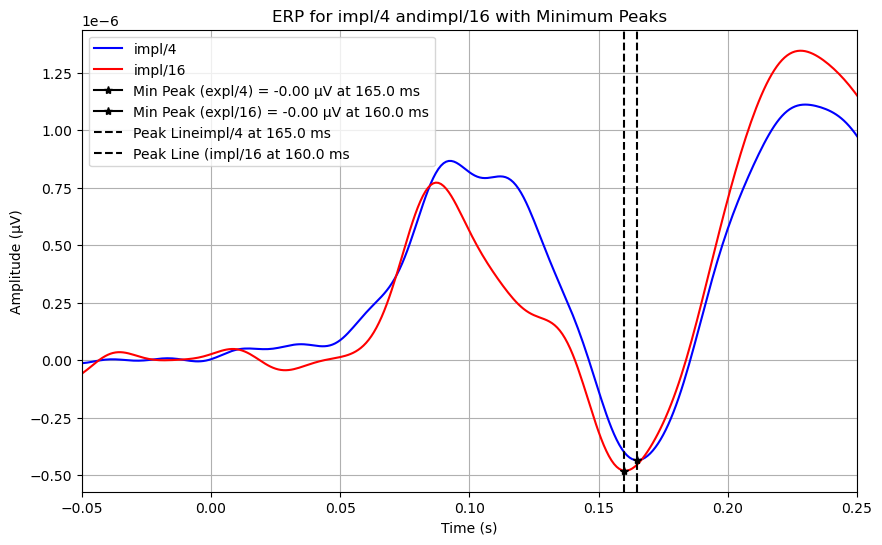

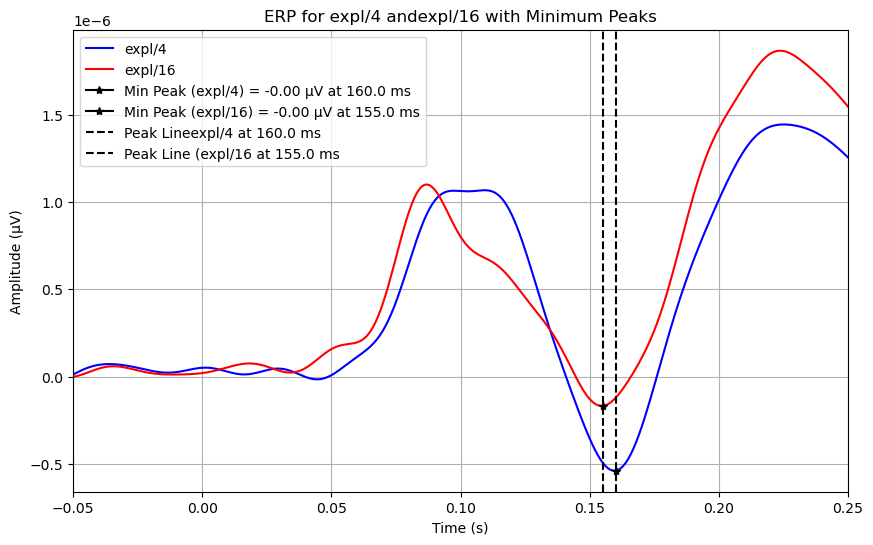

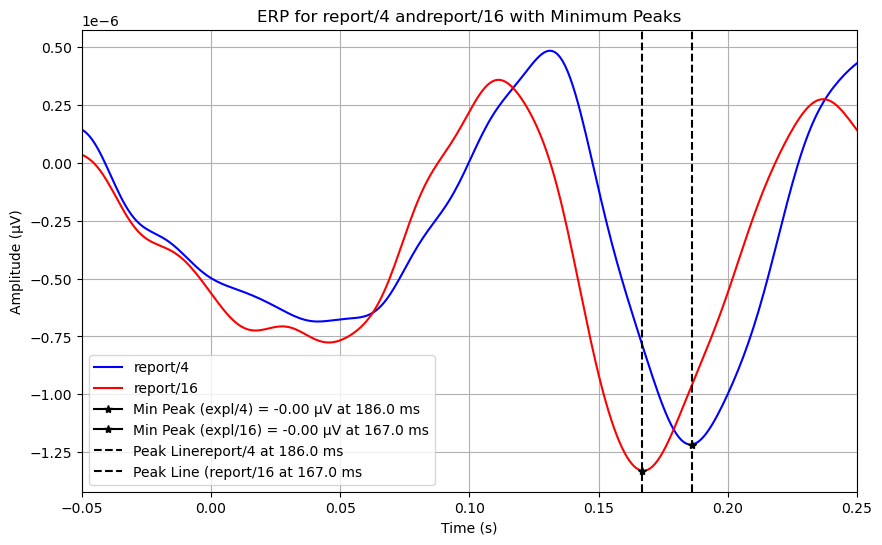

In [10]:

comparisons = [
    ("impl/4", "impl/16"),
    ("expl/4", "expl/16"),
    ("report/4", "report/16"),
]
tmin, tmax = 0.100, 0.200
for key_4, key_16 in comparisons:
    # Получение данных для каждого из условий
    evoked_4 = grand_averages[key_4]
    evoked_16 = grand_averages[key_16]
    
    
    # Получаем временные и амплитудные данные
    time_data = evoked_4.times  # Время
    signal_data_4 = evoked_4.data.mean(axis=0)  # Средняя амплитуда для всех каналов (стандартный стимул)
    signal_data_16 = evoked_16.data.mean(axis=0)  # Средняя амплитуда для всех каналов (девиантный стимул)
    
    # Индексы, которые соответствуют времени в диапазоне от tmin до tmax
    time_indices_4 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    time_indices_16 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    
    # Извлекаем данные в этом временном диапазоне
    signal_window_4 = signal_data_4[time_indices_4]
    signal_window_16 = signal_data_16[time_indices_16]
    time_window_4 = time_data[time_indices_4]
    time_window_16 = time_data[time_indices_16]
    
    # Находим индекс минимальной амплитуды (отрицательного пика)
    peak_idx_4 = np.argmin(signal_window_4)  # Для отрицательного пика
    peak_idx_16 = np.argmin(signal_window_16)  # Для отрицательного пика
    
    # Время и амплитуда пиков
    peak_time_4 = time_window_4[peak_idx_4]
    peak_amp_4 = signal_window_4[peak_idx_4]
    peak_time_16 = time_window_16[peak_idx_16]
    peak_amp_16 = signal_window_16[peak_idx_16]
    
    # Создаем график
    plt.figure(figsize=(10, 6))

    # Стандартный стимул (expl/4)
    plt.plot(time_data, signal_data_4, label= f"{key_4}", color='blue')
    
    # Девиантный стимул (expl/16)
    plt.plot(time_data, signal_data_16, label=f"{key_16}", color='red')
    
    # Добавляем точку для минимального пика для Report 4
    plt.plot(peak_time_4, peak_amp_4, marker='*', color='black', label=f'Min Peak (expl/4) = {peak_amp_4:.2f} µV at {peak_time_4*1000:.1f} ms')
    
    # Добавляем точку для минимального пика для Report 16
    plt.plot(peak_time_16, peak_amp_16, marker='*', color='black', label=f'Min Peak (expl/16) = {peak_amp_16:.2f} µV at {peak_time_16*1000:.1f} ms')
    
    # Добавляем вертикальные линии для пиков
    plt.axvline(peak_time_4, color='black', linestyle='--', label=f'Peak Line{key_4} at {peak_time_4*1000:.1f} ms')
    plt.axvline(peak_time_16, color='black', linestyle='--', label=f'Peak Line ({key_16} at {peak_time_16*1000:.1f} ms')
    
    # Настройка графика
    plt.title(f'ERP for {key_4} and{key_16} with Minimum Peaks')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude (µV)')
    plt.legend()
    plt.xlim(-0.05, 0.25)  # Обрезаем ось X для удобства (например, от -50 до 250 мс)
    plt.grid(True)
    plt.show()




По количеству лиц 170 - 270

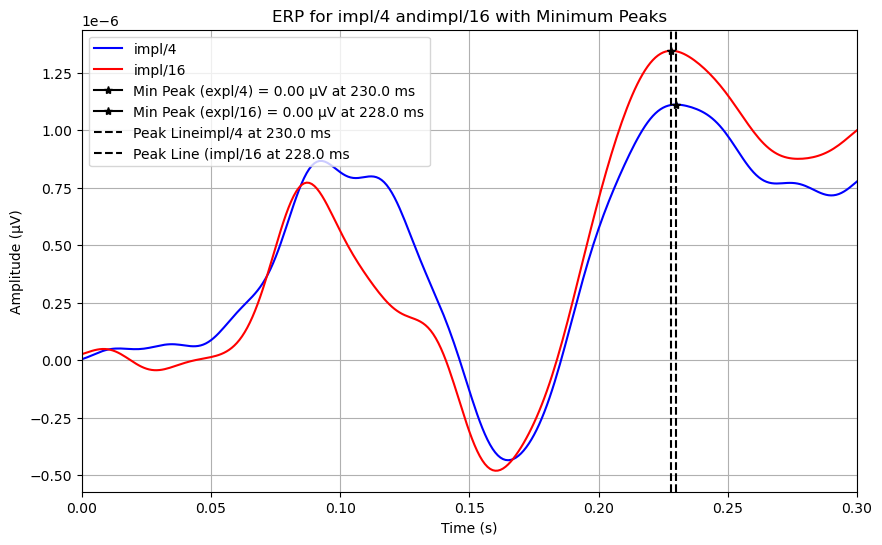

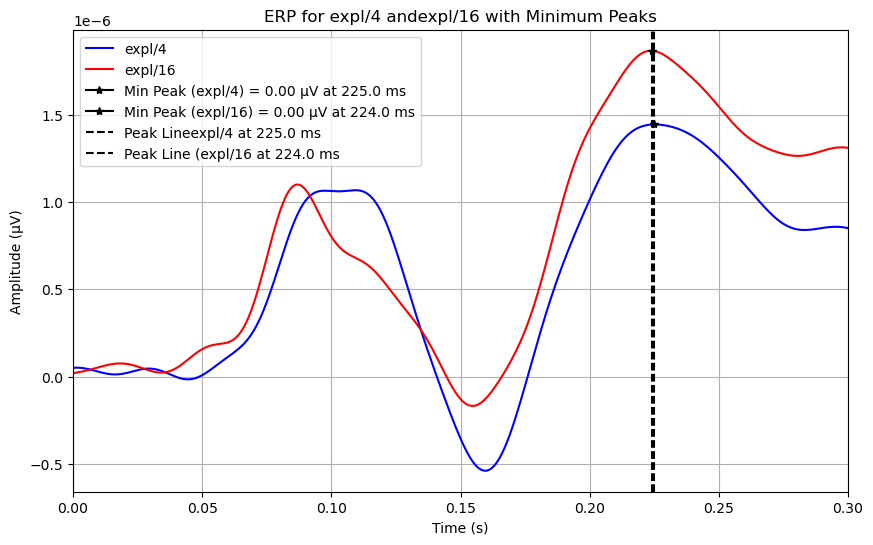

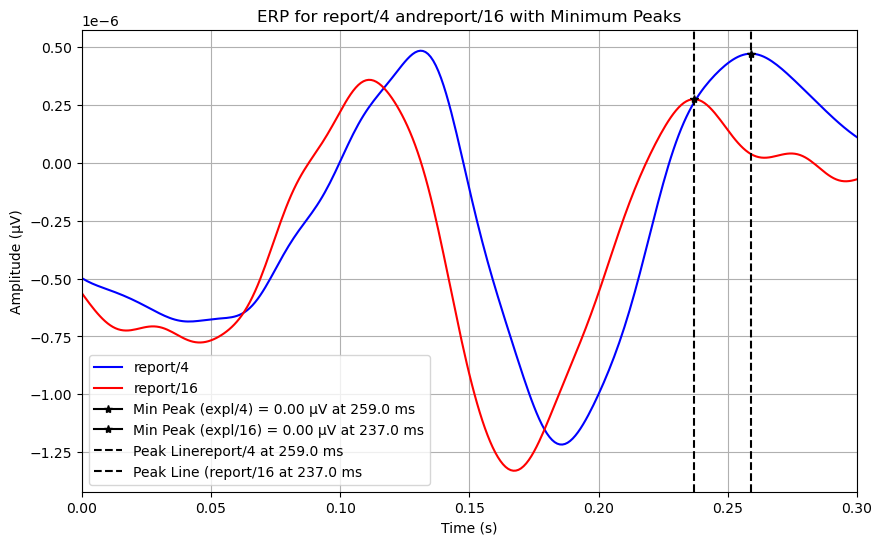

In [12]:

comparisons = [
    ("impl/4", "impl/16"),
    ("expl/4", "expl/16"),
    ("report/4", "report/16"),
]
tmin, tmax = 0.170, 0.270
for key_4, key_16 in comparisons:
    # Получение данных для каждого из условий
    evoked_4 = grand_averages[key_4]
    evoked_16 = grand_averages[key_16]
    
    
    # Получаем временные и амплитудные данные
    time_data = evoked_4.times  # Время
    signal_data_4 = evoked_4.data.mean(axis=0)  # Средняя амплитуда для всех каналов (стандартный стимул)
    signal_data_16 = evoked_16.data.mean(axis=0)  # Средняя амплитуда для всех каналов (девиантный стимул)
    
    # Индексы, которые соответствуют времени в диапазоне от tmin до tmax
    time_indices_4 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    time_indices_16 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    
    # Извлекаем данные в этом временном диапазоне
    signal_window_4 = signal_data_4[time_indices_4]
    signal_window_16 = signal_data_16[time_indices_16]
    time_window_4 = time_data[time_indices_4]
    time_window_16 = time_data[time_indices_16]
    
    # Находим индекс минимальной амплитуды (отрицательного пика)
    peak_idx_4 = np.argmax(signal_window_4)  # Для отрицательного пика
    peak_idx_16 = np.argmax(signal_window_16)  # Для отрицательного пика
    
    # Время и амплитуда пиков
    peak_time_4 = time_window_4[peak_idx_4]
    peak_amp_4 = signal_window_4[peak_idx_4]
    peak_time_16 = time_window_16[peak_idx_16]
    peak_amp_16 = signal_window_16[peak_idx_16]
    
    # Создаем график
    plt.figure(figsize=(10, 6))

    # Стандартный стимул (expl/4)
    plt.plot(time_data, signal_data_4, label= f"{key_4}", color='blue')
    
    # Девиантный стимул (expl/16)
    plt.plot(time_data, signal_data_16, label=f"{key_16}", color='red')
    
    # Добавляем точку для минимального пика для Report 4
    plt.plot(peak_time_4, peak_amp_4, marker='*', color='black', label=f'Min Peak (expl/4) = {peak_amp_4:.2f} µV at {peak_time_4*1000:.1f} ms')
    
    # Добавляем точку для минимального пика для Report 16
    plt.plot(peak_time_16, peak_amp_16, marker='*', color='black', label=f'Min Peak (expl/16) = {peak_amp_16:.2f} µV at {peak_time_16*1000:.1f} ms')
    
    # Добавляем вертикальные линии для пиков
    plt.axvline(peak_time_4, color='black', linestyle='--', label=f'Peak Line{key_4} at {peak_time_4*1000:.1f} ms')
    plt.axvline(peak_time_16, color='black', linestyle='--', label=f'Peak Line ({key_16} at {peak_time_16*1000:.1f} ms')
    
    # Настройка графика
    plt.title(f'ERP for {key_4} and{key_16} with Minimum Peaks')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude (µV)')
    plt.legend()
    plt.xlim(-0.0, 0.3)  # Обрезаем ось X для удобства (например, от -50 до 250 мс)
    plt.grid(True)
    plt.show()




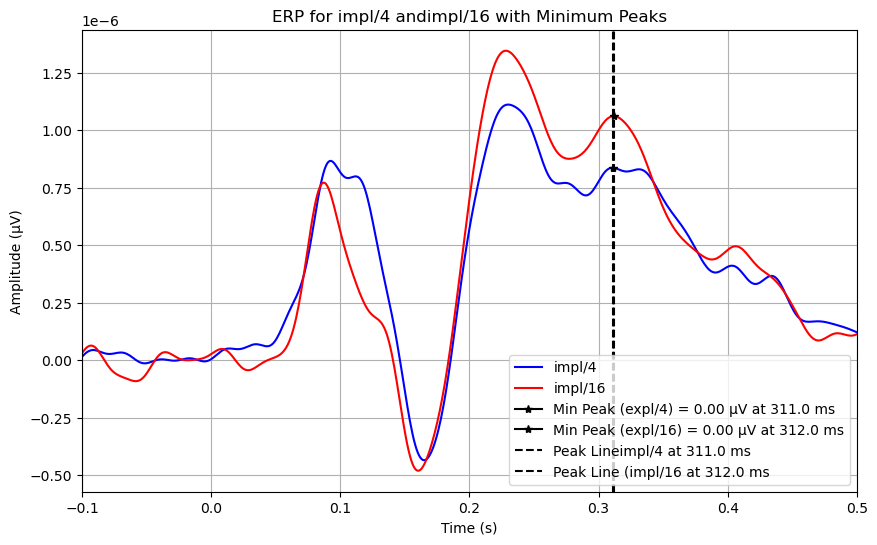

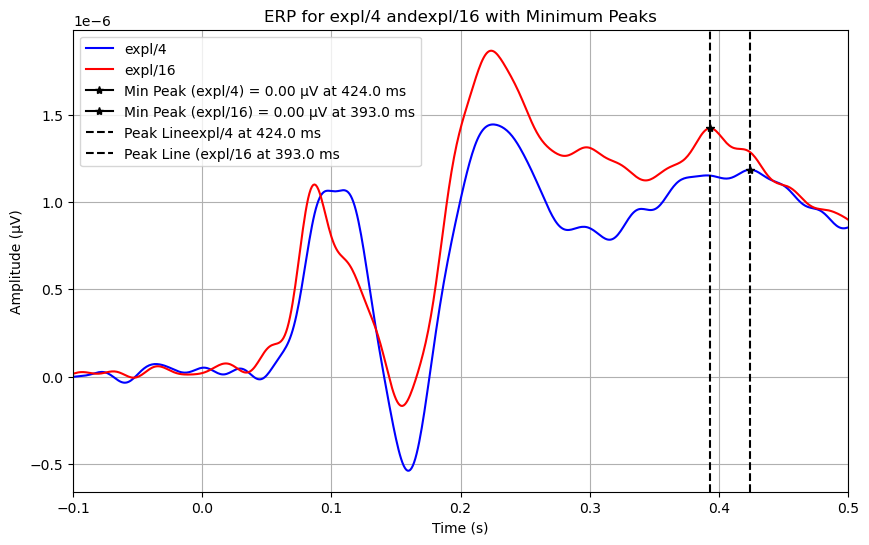

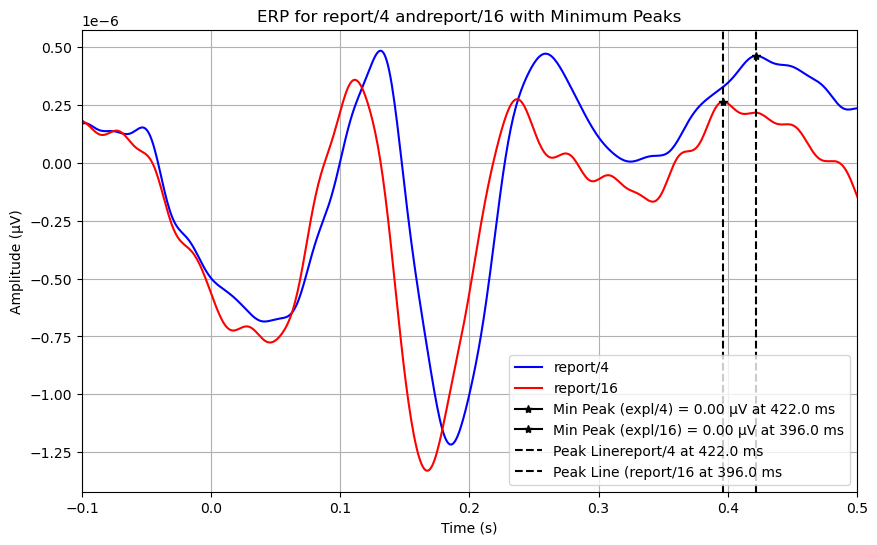

In [14]:

comparisons = [
    ("impl/4", "impl/16"),
    ("expl/4", "expl/16"),
    ("report/4", "report/16"),
]
tmin, tmax = 0.270, 0.500
for key_4, key_16 in comparisons:
    # Получение данных для каждого из условий
    evoked_4 = grand_averages[key_4]
    evoked_16 = grand_averages[key_16]
    
    
    # Получаем временные и амплитудные данные
    time_data = evoked_4.times  # Время
    signal_data_4 = evoked_4.data.mean(axis=0)  # Средняя амплитуда для всех каналов (стандартный стимул)
    signal_data_16 = evoked_16.data.mean(axis=0)  # Средняя амплитуда для всех каналов (девиантный стимул)
    
    # Индексы, которые соответствуют времени в диапазоне от tmin до tmax
    time_indices_4 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    time_indices_16 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    
    # Извлекаем данные в этом временном диапазоне
    signal_window_4 = signal_data_4[time_indices_4]
    signal_window_16 = signal_data_16[time_indices_16]
    time_window_4 = time_data[time_indices_4]
    time_window_16 = time_data[time_indices_16]
    
    # Находим индекс минимальной амплитуды (отрицательного пика)
    peak_idx_4 = np.argmax(signal_window_4)  # Для отрицательного пика
    peak_idx_16 = np.argmax(signal_window_16)  # Для отрицательного пика
    
    # Время и амплитуда пиков
    peak_time_4 = time_window_4[peak_idx_4]
    peak_amp_4 = signal_window_4[peak_idx_4]
    peak_time_16 = time_window_16[peak_idx_16]
    peak_amp_16 = signal_window_16[peak_idx_16]
    
    # Создаем график
    plt.figure(figsize=(10, 6))

    # Стандартный стимул (expl/4)
    plt.plot(time_data, signal_data_4, label= f"{key_4}", color='blue')
    
    # Девиантный стимул (expl/16)
    plt.plot(time_data, signal_data_16, label=f"{key_16}", color='red')
    
    # Добавляем точку для минимального пика для Report 4
    plt.plot(peak_time_4, peak_amp_4, marker='*', color='black', label=f'Min Peak (expl/4) = {peak_amp_4:.2f} µV at {peak_time_4*1000:.1f} ms')
    
    # Добавляем точку для минимального пика для Report 16
    plt.plot(peak_time_16, peak_amp_16, marker='*', color='black', label=f'Min Peak (expl/16) = {peak_amp_16:.2f} µV at {peak_time_16*1000:.1f} ms')
    
    # Добавляем вертикальные линии для пиков
    plt.axvline(peak_time_4, color='black', linestyle='--', label=f'Peak Line{key_4} at {peak_time_4*1000:.1f} ms')
    plt.axvline(peak_time_16, color='black', linestyle='--', label=f'Peak Line ({key_16} at {peak_time_16*1000:.1f} ms')
    
    # Настройка графика
    plt.title(f'ERP for {key_4} and{key_16} with Minimum Peaks')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude (µV)')
    plt.legend()
    plt.xlim(-0.1, 0.5)  # Обрезаем ось X для удобства (например, от -50 до 250 мс)
    plt.grid(True)
    plt.show()




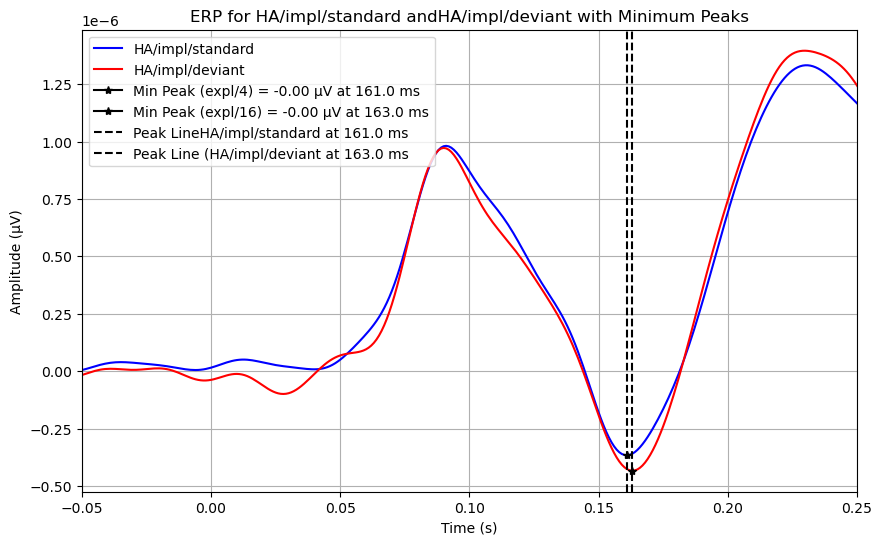

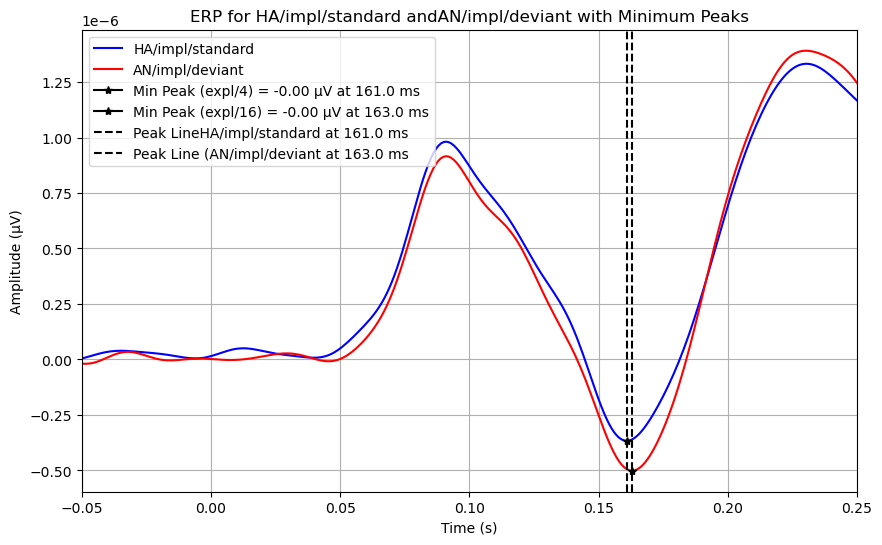

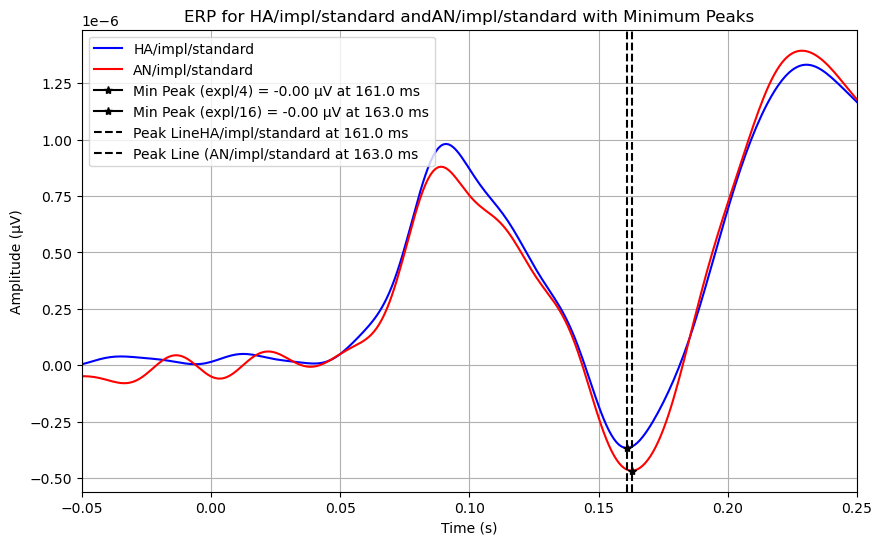

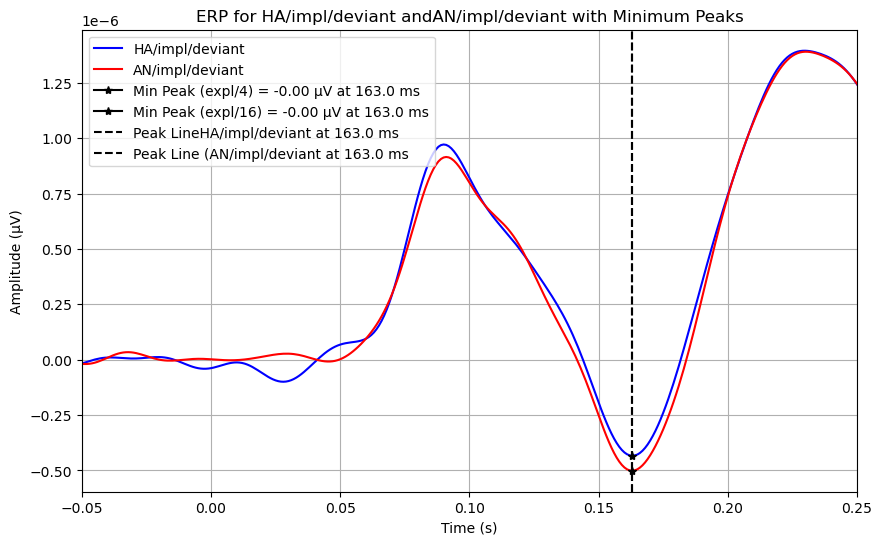

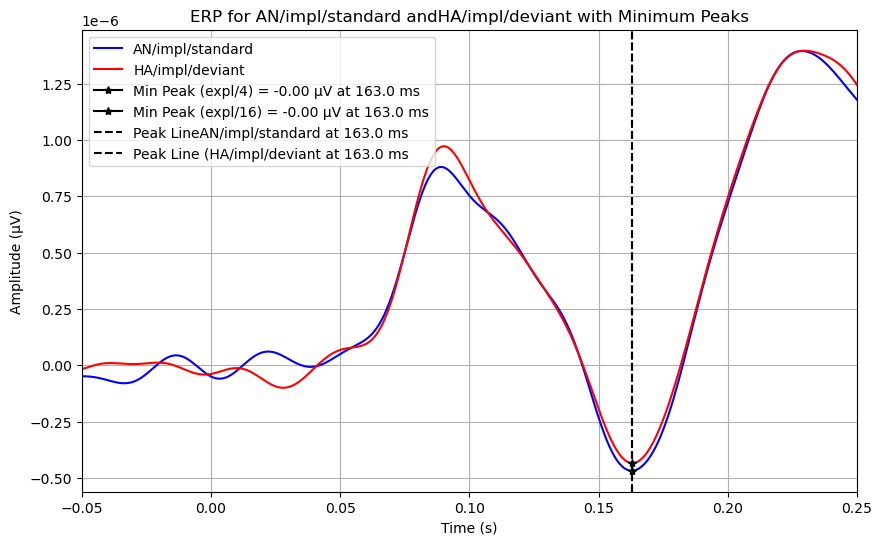

...

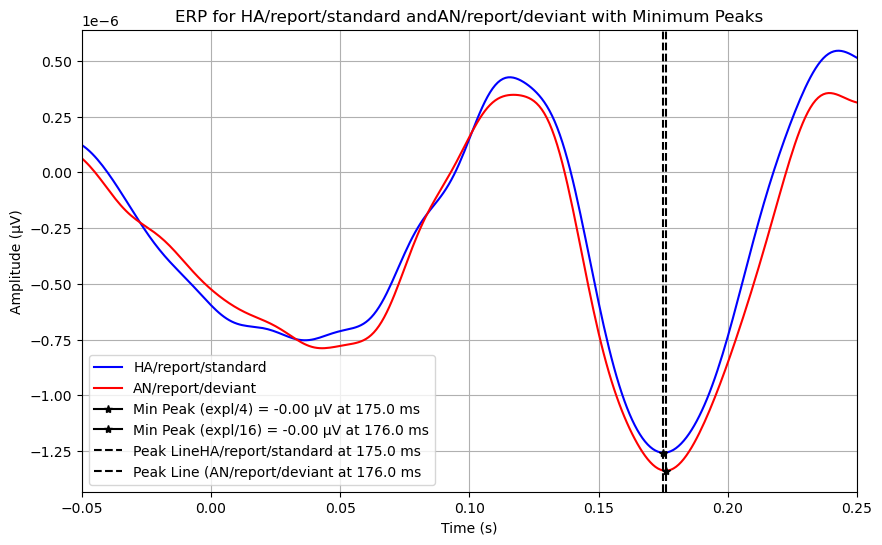

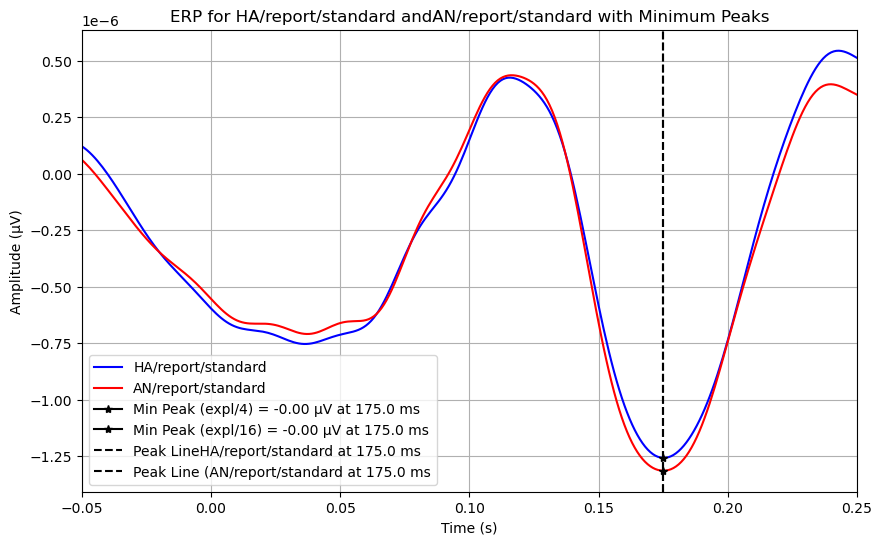

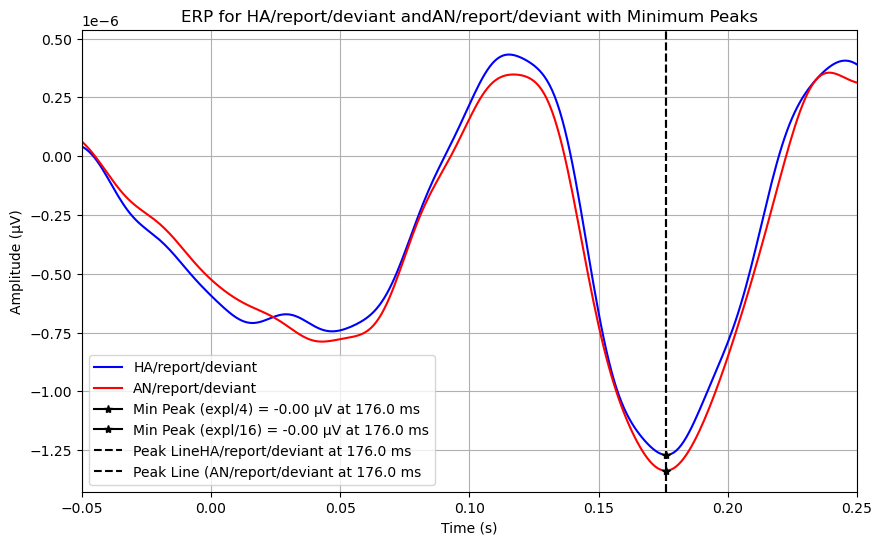

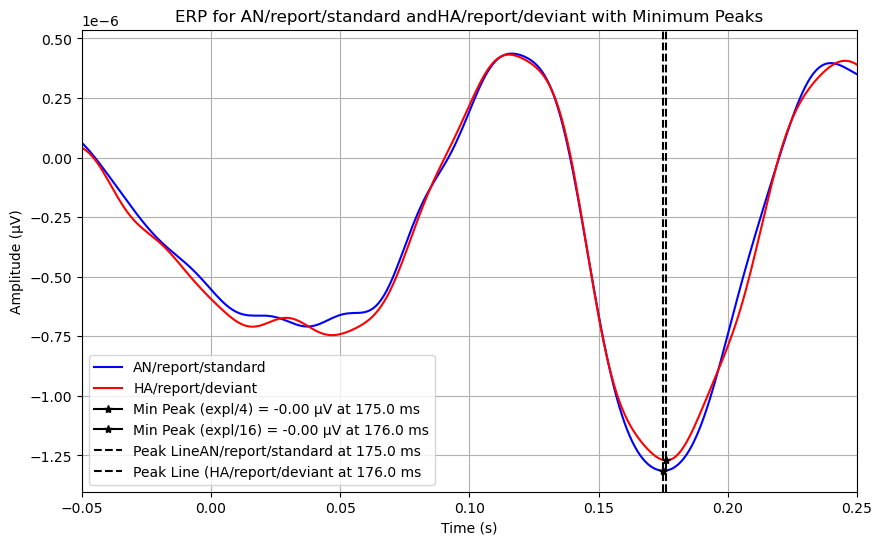

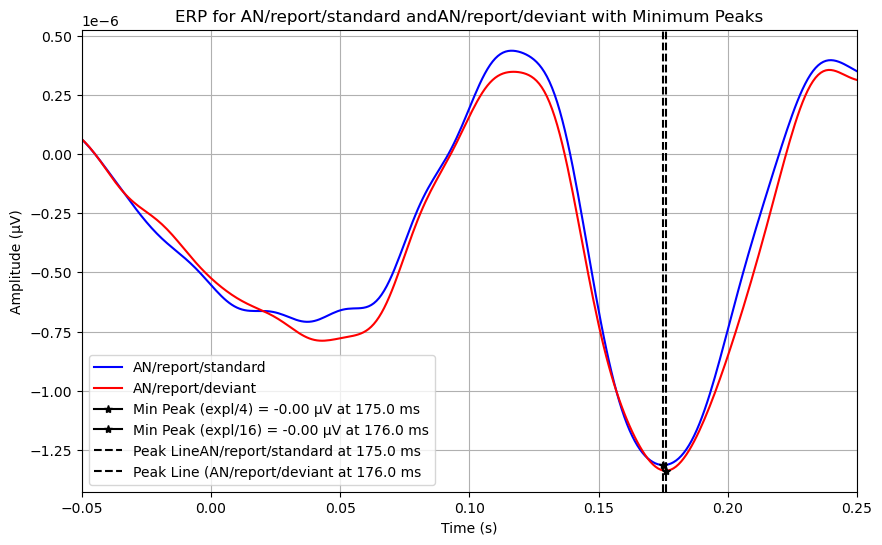

In [175]:
# Сравниваемые пары условий
comparisons = [
    ("HA/impl/standard", "HA/impl/deviant"),
    ("HA/impl/standard", "AN/impl/deviant"),
    ("HA/impl/standard", "AN/impl/standard"),
    ("HA/impl/deviant", "AN/impl/deviant"),
    ("AN/impl/standard", "HA/impl/deviant"),
    ("AN/impl/standard", "AN/impl/deviant"),
    
    ("HA/expl/standard", "HA/expl/deviant"),
    ("HA/expl/standard", "AN/expl/deviant"),
    ("HA/expl/standard", "AN/expl/standard"),
    ("HA/expl/deviant", "AN/expl/deviant"),
    ("AN/expl/standard", "HA/expl/deviant"),
    ("AN/expl/standard", "AN/expl/deviant"),
    
    ("HA/report/standard", "HA/report/deviant"),
    ("HA/report/standard", "AN/report/deviant"),
    ("HA/report/standard", "AN/report/standard"),
    ("HA/report/deviant", "AN/report/deviant"),
    ("AN/report/standard", "HA/report/deviant"),
    ("AN/report/standard", "AN/report/deviant")
]

tmin, tmax = 0.100, 0.200
for key_4, key_16 in comparisons:
    # Получение данных для каждого из условий
    evoked_4 = grand_averages[key_4]
    evoked_16 = grand_averages[key_16]
    
    
    # Получаем временные и амплитудные данные
    time_data = evoked_4.times  # Время
    signal_data_4 = evoked_4.data.mean(axis=0)  # Средняя амплитуда для всех каналов (стандартный стимул)
    signal_data_16 = evoked_16.data.mean(axis=0)  # Средняя амплитуда для всех каналов (девиантный стимул)
    
    # Индексы, которые соответствуют времени в диапазоне от tmin до tmax
    time_indices_4 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    time_indices_16 = np.where((time_data >= tmin) & (time_data <= tmax))[0]
    
    # Извлекаем данные в этом временном диапазоне
    signal_window_4 = signal_data_4[time_indices_4]
    signal_window_16 = signal_data_16[time_indices_16]
    time_window_4 = time_data[time_indices_4]
    time_window_16 = time_data[time_indices_16]
    
    # Находим индекс минимальной амплитуды (отрицательного пика)
    peak_idx_4 = np.argmin(signal_window_4)  # Для отрицательного пика
    peak_idx_16 = np.argmin(signal_window_16)  # Для отрицательного пика
    
    # Время и амплитуда пиков
    peak_time_4 = time_window_4[peak_idx_4]
    peak_amp_4 = signal_window_4[peak_idx_4]
    peak_time_16 = time_window_16[peak_idx_16]
    peak_amp_16 = signal_window_16[peak_idx_16]
    
    # Создаем график
    plt.figure(figsize=(10, 6))

    # Стандартный стимул (expl/4)
    plt.plot(time_data, signal_data_4, label= f"{key_4}", color='blue')
    
    # Девиантный стимул (expl/16)
    plt.plot(time_data, signal_data_16, label=f"{key_16}", color='red')
    
    # Добавляем точку для минимального пика для Report 4
    plt.plot(peak_time_4, peak_amp_4, marker='*', color='black', label=f'Min Peak (expl/4) = {peak_amp_4:.2f} µV at {peak_time_4*1000:.1f} ms')
    
    # Добавляем точку для минимального пика для Report 16
    plt.plot(peak_time_16, peak_amp_16, marker='*', color='black', label=f'Min Peak (expl/16) = {peak_amp_16:.2f} µV at {peak_time_16*1000:.1f} ms')
    
    # Добавляем вертикальные линии для пиков
    plt.axvline(peak_time_4, color='black', linestyle='--', label=f'Peak Line{key_4} at {peak_time_4*1000:.1f} ms')
    plt.axvline(peak_time_16, color='black', linestyle='--', label=f'Peak Line ({key_16} at {peak_time_16*1000:.1f} ms')
    
    # Настройка графика
    plt.title(f'ERP for {key_4} and{key_16} with Minimum Peaks')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude (µV)')
    plt.legend()
    plt.xlim(-0.05, 0.25)  # Обрезаем ось X для удобства (например, от -50 до 250 мс)
    plt.grid(True)
    plt.show()


